# Operation Manual

#### Step 1:

Loading and preprocessing the images using the fucntion load_and_preprocess_v3().

In [443]:
# Example with 1 image
card_img_path = "card_red_1.jpg"
card_img_preprocessed = load_and_preprocess_v3(card_img_path)

#### Step 2: 

Extracting the features from the images using extract_features3() or using preprocess_and_extract_features()
to preproces image and then extract the features.

In [444]:
# Example with 1 image
card_features = extract_features3(card_img_preprocessed)
card_features

{'Hu Moments': 0.0006998523914068604,
 'HOG Features': 231.67707276453334,
 'LBP Histogram': 0.9924232217700696,
 'Mean': 73.11938,
 'Standard Deviation': 115.32128237413764,
 'Skewness': 0.8644762788439412,
 'Kurtosis': 1.110533953269437,
 'PCA Features': 3.1622776601683795}

#### Step 3:

Calcuating the feature diffrences between the images and a refference image (template for correct image) for the anomaly detection stage.

In [447]:
# Example
card_features_2 = preprocess_and_extract_features("card_red_2.jpg")
cards_features_diffrences = calculate_feature_differences(card_features,card_features_2)
cards_features_diffrences

{'Hu Moments': 3.511567774766317e-07,
 'HOG Features': 3.3661731687309384,
 'LBP Histogram': 5.55571251636966e-05,
 'Mean': 1.5779400000000123,
 'Standard Deviation': 0.7573719890324355,
 'Skewness': 0.008270796460774443,
 'Kurtosis': 0.0648613545959622,
 'PCA Features': 1.7763568394002505e-15}

#### Step 4:

Create set of threshold ranges then apply the threshold optimization fucntion to find the best thresholds.

In [448]:
# Threshold ranges example
"""
    threshold_ranges_example = {
    'Hu Moments': [1e-6, 1.5e-6, 2e-6 2.5e-6, 3e-6,],
    'HOG Features': [0.8, 0.9, 1.0, 1.1, 1.2],
    "LBP Histogram": [0.0004, 0.0005, 0.0006, 0.0007],
    "PCA Features": [1e-16 ,2e-16 , 4e-16 , 6e-16, 8e-16, 1e-15]
    }
    
"""
# After making our threshold ranges then we create all the thresholds combinations for the threshold optimization
"""
    thresholds_dict_example = thresholds_dicts(threshold_ranges_example)
"""
# Calcuating features diffrences of our images (imgs_list) with the template (feat_refference)
"""
    features_diff_list = calc_feat_diff_all(imgs_list,feat_refference)
"""
# Using the extracted features diffrences (features_diff_list) and the lables we split our data
# Example usage for the tran/val spit
""" 
    X_train, X_val, y_train, y_val = train_val_split(features_diff_list,labels,0.2, 42)
    
    print("F1-score:", val_f1 
"""
# After spliting the data using the optimize thresholds function to find the best thresholds
"""
    best_thresholds, best_f1_score = optimize_thresholds_v2(thresholds_dict_example, X_train, y_train)
"""
# After usign the threshold optimization we validate the results on the validation set
"""
    val_f1 = validating_thresholds(X_val,y_val,best_thresholds,detect_anomalies5)
"""


'\n    threshold_ranges_example = {\n    \'Hu Moments\': [1e-6, 1.5e-6, 2e-6 2.5e-6, 3e-6,],\n    \'HOG Features\': [0.8, 0.9, 1.0, 1.1, 1.2],\n    "LBP Histogram": [0.0004, 0.0005, 0.0006, 0.0007],\n    "PCA Features": [1e-16,2e-16,3e-16,4e-16, 5e-16, 6e-16, 7e-16, 8e-16, 9e-16, 1e-15, 5e-15, 1e-14]\n}\n\n'

# Imports

In [353]:
import cv2
import numpy as np
import pandas as pd
import itertools
import matplotlib.pyplot as plt
from skimage import feature,measure, morphology
import mahotas as mh  # Import Mahotas for Zernike Moments
from scipy.stats import kurtosis
from sklearn.decomposition import PCA
from sklearn.metrics import precision_score,recall_score,f1_score,roc_auc_score,confusion_matrix, accuracy_score
from sklearn.model_selection import train_test_split
import seaborn as sns
from mpl_toolkits.mplot3d import Axes3D




# Loading and preprocesing the images

Made few diffrent preprocessing to find the best way for the deformities i wanted to detect as anomalies

In [2]:
def load_and_preprocess_v1(original_image_path):
    
    # Load the original image
    original_image = cv2.imread(original_image_path)
    
    # Convert the image to grayscale
    gray_image = cv2.cvtColor(original_image, cv2.COLOR_BGR2GRAY)
    
    # Apply Gaussian blur to reduce noise and enhance contrast
    blurred_image = cv2.GaussianBlur(gray_image, (9, 9), 0)
   
    # Apply a bilateral filter to further denoise the image
    denoised_image = cv2.bilateralFilter(blurred_image, d=3, sigmaColor=75, sigmaSpace=75)

    # Create a binary mask by applying adaptive thresholding
    binary_mask = cv2.adaptiveThreshold(denoised_image, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 21, 5)


    # Further refine the object mask necessary using morphological operations
    kernel = np.ones((4, 4), np.uint8)
    #object_masked = cv2.morphologyEx(object_masked, cv2.MORPH_CLOSE, kernel)
    #object_masked = cv2.morphologyEx(object_masked, cv2.MORPH_OPEN, kernel)
    #object_masked = cv2.dilate(binary_mask, kernel, iterations=1)
    object_masked = cv2.erode(binary_mask, kernel, iterations=1)
    
    # Create a result image with a  white/black background
    result = np.full_like(original_image, (0, 0, 0), dtype=np.uint8)

    # Copy the object from the original image to the result based on the object mask
    result[object_masked == 0] = (255, 255, 255)  # Set background to white/black

    
    # Display the result
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.title("Original Image")
    plt.imshow(cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB))

    plt.subplot(1, 2, 2)
    plt.title("Background Removed")
    plt.imshow(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))

    plt.tight_layout()
    plt.show()

In [3]:
def load_and_preprocess_v2(original_image_path):
       
    # Load the original image 
    original_image = cv2.imread(original_image_path)

    # Convert the image to grayscale
    gray_image = cv2.cvtColor(original_image, cv2.COLOR_BGR2GRAY)
    
    # Apply Gaussian blur to reduce noise and enhance contrast
    blurred_image = cv2.GaussianBlur(gray_image, (9, 9), 0)

    # Apply a bilateral filter to further denoise the image
    denoised_image = cv2.bilateralFilter(blurred_image, d=3, sigmaColor=75, sigmaSpace=75)

    # Create a binary mask by applying adaptive thresholding
    binary_mask = cv2.adaptiveThreshold(denoised_image, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 21, 5)

    # Further refine the image using morphological operations
    kernel = np.ones((4, 4), np.uint8)
    morphed_image = cv2.erode(binary_mask, kernel, iterations=1)
    
    # Create a result image with a  white/black background
    result = np.full_like(original_image, (0, 0, 0), dtype=np.uint8)

    # Copy the object from the original image to the result based on the object mask
    result[morphed_image == 0] = (255, 255, 255)  # Set background to white/black
    
    result = result[:, :, 0]

    return result

#### Had to resize the images because the images i had procured (taken myself) were too big, extracting thier features took too much computing power so i had to make them smaller.

In [151]:
def load_and_preprocess_v3(original_image_path):
    
    # Load the original image 
    original_image = cv2.imread(original_image_path)
    
    # Resizing the image
    new_width = 750
    new_height = 1000
    original_image = cv2.resize(original_image, (new_width, new_height))
    
    # Convert the image to grayscale
    gray_image = cv2.cvtColor(original_image, cv2.COLOR_BGR2GRAY)
    
    # Apply Gaussian blur to reduce noise and enhance contrast
    blurred_image = cv2.GaussianBlur(gray_image, (9, 9), 0)

    # Apply a bilateral filter to further denoise the image
    denoised_image = cv2.bilateralFilter(blurred_image, d=3, sigmaColor=75, sigmaSpace=75)

    # Create a binary mask by applying adaptive thresholding
    binary_mask = cv2.adaptiveThreshold(denoised_image, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 21, 5)

    # Further refine the object mask if necessary using morphological operations
    kernel = np.ones((5, 5), np.uint8)
    object_masked = cv2.erode(binary_mask, kernel, iterations=9)
    
    # Create a result image with a  white/black background
    result = np.full_like(original_image, (0, 0, 0), dtype=np.uint8)

    # Copy the object from the original image to the result based on the object mask
    result[object_masked == 0] = (255, 255, 255)  # Set background to white/black
    
    result = result[:, :, 0]
    
    return result


# Feature Extraction

I have made few versions of feature extraction because of diffrent trials for anomality detection and threshold optimisation , also trying diffrent features.

In [5]:
def extract_features1(binary_image):
    # Dictionary to store extracted features
    features = {}

    # Hu Moments
    hu_moments = cv2.HuMoments(cv2.moments(binary_image)).flatten()
    features['Hu Moments'] = hu_moments

    # HOG Features
    hog = cv2.HOGDescriptor()
    hog_features = hog.compute(binary_image)
    features['HOG Features'] = hog_features.tolist()

    # Local Binary Pattern (LBP)
    radius = 3
    n_points = 8 * radius
    lbp_image = feature.local_binary_pattern(binary_image, n_points, radius, method='uniform')
    lbp_hist, _ = np.histogram(lbp_image.ravel(), bins=np.arange(0, n_points + 3), range=(0, n_points + 2))
    lbp_hist = lbp_hist.astype("float")
    lbp_hist /= (lbp_hist.sum() + 1e-6)
    features['LBP Histogram'] = lbp_hist.tolist()

    # SIFT Features
    sift = cv2.SIFT_create()
    keypoints, sift_features = sift.detectAndCompute(binary_image, None)
    features['SIFT Features'] = sift_features.tolist()

    # ORB Features (Alternative to SURF)
    orb = cv2.ORB_create()
    keypoints, orb_features = orb.detectAndCompute(binary_image, None)
    features['ORB Features'] = orb_features.tolist()

    # Harris Corner Features
    harris_corners = cv2.cornerHarris(binary_image, blockSize=2, ksize=3, k=0.04)
    harris_corners = cv2.dilate(harris_corners, None)
    corner_coordinates = np.argwhere(harris_corners > 0.01 * harris_corners.max())
    features['Harris Corners'] = corner_coordinates.tolist()

    # Edge Histograms
    edges = feature.canny(binary_image)
    edge_histogram, _ = np.histogram(binary_image[edges], bins=256, range=(0, 256))
    features['Edge Histogram'] = edge_histogram.tolist()

    # Statistical Moments
    mean = np.mean(binary_image)
    std_dev = np.std(binary_image)
    skewness = measure.shannon_entropy(binary_image)
    kurtosis_value = kurtosis(binary_image.ravel())
    features['Mean'] = mean
    features['Standard Deviation'] = std_dev
    features['Skewness'] = skewness
    features['Kurtosis'] = kurtosis_value

    # Principal Component Analysis (PCA)
    # Apply PCA to the image to reduce dimensionality
    pca = PCA(n_components=10)
    pca.fit(binary_image)
    pca_features = pca.components_
    features['PCA Features'] = pca_features.tolist()
    
    return features


In [6]:
def extract_features3(binary_image):
    # Dictionary to store extracted features
    features = {}
    
    # Hu Moments
    hu_moments = cv2.HuMoments(cv2.moments(binary_image)).flatten()
    hu_moments = np.linalg.norm(np.array(hu_moments))
    features['Hu Moments'] = hu_moments

    # HOG Features
    hog = cv2.HOGDescriptor()
    hog_features = hog.compute(binary_image)
    hog_features = np.linalg.norm(np.array(hog_features.tolist()))
    features['HOG Features'] = hog_features

    # Local Binary Pattern (LBP)
    radius = 3
    n_points = 8 * radius
    lbp_image = feature.local_binary_pattern(binary_image, n_points, radius, method='uniform')
    lbp_hist, _ = np.histogram(lbp_image.ravel(), bins=np.arange(0, n_points + 3), range=(0, n_points + 2))
    lbp_hist = lbp_hist.astype("float")
    lbp_hist /= (lbp_hist.sum() + 1e-6)
    lbp_hist = np.linalg.norm(np.array(lbp_hist.tolist()))
    features['LBP Histogram'] = lbp_hist

    # Statistical Moments
    mean = np.mean(binary_image)
    std_dev = np.std(binary_image)
    skewness = measure.shannon_entropy(binary_image)
    kurtosis_value = kurtosis(binary_image.ravel())
    mean = np.linalg.norm(np.array(mean))
    std_dev = np.linalg.norm(np.array(std_dev))
    skewness = np.linalg.norm(np.array(skewness))
    kurtosis_value = np.linalg.norm(np.array(kurtosis_value))
    
    features['Mean'] = mean
    features['Standard Deviation'] = std_dev
    features['Skewness'] = skewness
    features['Kurtosis'] = kurtosis_value

    # Set a fixed random seed for reproducibility
    random_seed = 42  

    # Principal Component Analysis (PCA)
    # Apply PCA to the image to reduce dimensionality
    pca = PCA(n_components=10, random_state=random_seed) 
    pca.fit(binary_image)
    pca_features = pca.components_
    pca_features = np.linalg.norm(np.array(pca_features.tolist()))
    features['PCA Features'] = pca_features

    
    return features


### Preprocessing and extraction features

In [7]:
def preprocess_and_extract_features(image_path):
    # Load image, preprocess it and then return the features extracted 
    # Load an image
    preprocessed_image = load_and_preprocess_v3(image_path)

    # Extract features from the preprocessed image
    features = extract_features3(preprocessed_image)

    # Release memory
    del preprocessed_image

    return features

### Calcualting feature diffrences (between template image and test image)

In [450]:
def calculate_feature_differences(ref_features, test_features):
    """
    Calculate the feature differences between two dictionaries of features.

    Parameters:
    - ref_features: Dictionary of features extracted from the reference image.
    - test_features: Dictionary of features extracted from the test image.

    Returns:
    - A dictionary containing the differences for each feature.
    """
    differences = {}

    # Calculate the differences for each feature

    # 1. Hu Moments Features Differences
    hu_ref = ref_features['Hu Moments']
    hu_test = test_features['Hu Moments']
    hu_distance = np.linalg.norm(np.array(hu_ref) - np.array(hu_test))
    differences['Hu Moments'] = hu_distance

    # 2. HOG Features Differences
    hog_ref = ref_features['HOG Features']
    hog_test = test_features['HOG Features']
    hog_distance = np.linalg.norm(np.array(hog_ref) - np.array(hog_test))
    differences['HOG Features'] = hog_distance

    # 3.LBP Histogram Features Differences
    lbp_ref = ref_features['LBP Histogram']
    lbp_test = test_features['LBP Histogram']
    lbp_distance = np.linalg.norm(np.array(lbp_ref) - np.array(lbp_test))
    differences['LBP Histogram'] = lbp_distance

    # 4. Statistical Moments Features Differences
    mean_ref = ref_features['Mean']
    mean_test = test_features['Mean']
    std_dev_ref = ref_features['Standard Deviation']
    std_dev_test = test_features['Standard Deviation']
    skewness_ref = ref_features['Skewness']
    skewness_test = test_features['Skewness']
    kurtosis_ref = ref_features['Kurtosis']
    kurtosis_test = test_features['Kurtosis']
    
    mean_distance = np.linalg.norm(np.array(mean_ref) - np.array(mean_test))
    differences['Mean']= mean_distance
    std_dev_distance = np.linalg.norm(np.array(std_dev_ref) - np.array(std_dev_test))
    differences['Standard Deviation']= std_dev_distance
    skewness_distance = np.linalg.norm(np.array(skewness_ref) - np.array(skewness_test))
    differences['Skewness']= skewness_distance
    kurtosis_distance = np.linalg.norm(np.array(kurtosis_ref) - np.array(kurtosis_test))
    differences['Kurtosis']= kurtosis_distance  

    # 5. PCA Features Differences
    pca_ref = ref_features['PCA Features']
    pca_test = test_features['PCA Features']
    pca_distance = np.linalg.norm(np.array(pca_ref) - np.array(pca_test))
    differences['PCA Features']= pca_distance 
    
    return differences

### Calcuating the feature diffrences from whole data set

In [458]:
def calc_feat_diff_all(imgs_list,feat_refference):
    """
        Input: 
              - imgs_list = list of all the images paths from the data set.
              - img_ref = the template image paths we used as reffrence.
        Output:
              - features_diffrences_list = the images features diffrences between the images from the list to the template.
    """
    
    extract_feats = []
    for img in imgs_list:
        img_f = preprocess_and_extract_features(img)
        extract_feats.append(img_f)
        del img_f

    feat_refference = preprocess_and_extract_features(img_ref)    
    features_diffrences_list = []
    for img_f in extract_feats:
        img_d = calculate_feature_differences(feat_refference,img_f)
        features_diffrences_list.append(img_d)
        del img_d
        
    return features_diffrences_list


### Calculating features statistics info to better understand them

In [197]:

def calculate_feature_statistics(features_list):
    """
    Calculate statistics (min, max, mean, and std deviation) for each feature across a list of feature dictionaries.

    Parameters:
    features_list (list): List of feature dictionaries.

    Returns:
    feature_statistics (dict): Dictionary containing statistics for each feature.
    """

    # Initialize dictionaries to store statistics for each feature
    feature_statistics = {}

    # Extract the list of feature names from the first dictionary
    feature_names = list(features_list[0].keys())

    # Iterate through each feature
    for feature_name in feature_names:
        # Extract values of the current feature from all dictionaries
        feature_values = [feature_dict[feature_name] for feature_dict in features_list]

        # Calculate statistics for the feature
        min_value = min(feature_values)
        max_value = max(feature_values)
        mean_value = np.mean(feature_values)
        std_deviation = np.std(feature_values)

        # Store statistics in the feature_statistics dictionary
        feature_statistics[feature_name] = {
            "Min": min_value,
            "Max": max_value,
            "Mean": mean_value,
            "Std Deviation": std_deviation,
        }

    return feature_statistics


# Anomalites detection

Various versons of detect_anomlies function was made based on changes and trials , 
finding the best thresholds and discarding features that thier information is not that valuable for the detection, 
such as some features are more variant to changes in object orientation,position,rotation and such.

#### Anomalies detection using threshold on each feature

In [8]:
def detect_anomalies3(ref_features, test_features, thresholds):
    """
    Detect anomalies in an image using multiple features and thresholds.

    Parameters:
    - ref_features: Dictionary of features extracted from the reference image.
    - test_features: Dictionary of features extracted from the test image.
    - thresholds: Dictionary of threshold values for each feature.

    Returns:
    - True if any feature exceeds its threshold, indicating an anomaly. False otherwise.
    """
    # Initialize a flag to track anomalies
    anomaly_detected = False

    # 1. Compare Hu Moments
    hu_ref = ref_features['Hu Moments']
    hu_test = test_features['Hu Moments']
    hu_distance = np.linalg.norm(np.array(hu_ref) - np.array(hu_test))
    if hu_distance > thresholds['Hu Moments']:
        anomaly_detected = True

    # 2. Compare HOG Features
    hog_ref = ref_features['HOG Features']
    hog_test = test_features['HOG Features']
    hog_distance = np.linalg.norm(np.array(hog_ref) - np.array(hog_test))
    if hog_distance > thresholds['HOG Features']:
        anomaly_detected = True

    # 3. Compare LBP Histogram
    lbp_ref = ref_features['LBP Histogram']
    lbp_test = test_features['LBP Histogram']
    lbp_distance = np.linalg.norm(np.array(lbp_ref) - np.array(lbp_test))
    if lbp_distance > thresholds['LBP Histogram']:
        anomaly_detected = True

    # 4. Compare Statistical Moments 
    mean_ref = ref_features['Mean']
    mean_test = test_features['Mean']
    std_dev_ref = ref_features['Standard Deviation']
    std_dev_test = test_features['Standard Deviation']
    skewness_ref = ref_features['Skewness']
    skewness_test = test_features['Skewness']
    kurtosis_ref = ref_features['Kurtosis']
    kurtosis_test = test_features['Kurtosis']
    mean_distance = np.linalg.norm(np.array(mean_ref) - np.array(mean_test))
    if mean_distance > thresholds['Mean']:
        anomaly_detected = True
    std_dev_distance = np.linalg.norm(np.array(std_dev_ref) - np.array(std_dev_test))
    if std_dev_distance > thresholds['Standard Deviation']:
        anomaly_detected = True
    skewness_distance = np.linalg.norm(np.array(skewness_ref) - np.array(skewness_test))
    if skewness_distance > thresholds['Skewness']:
        anomaly_detected = True
    kurtosis_distance = np.linalg.norm(np.array(kurtosis_ref) - np.array(kurtosis_test))
    if kurtosis_distance > thresholds['Kurtosis']:
        anomaly_detected = True    

    # 5. Compare PCA Features
    pca_ref = ref_features['PCA Features']
    pca_test = test_features['PCA Features']
    pca_distance = np.linalg.norm(np.array(pca_ref) - np.array(pca_test))
    if pca_distance > thresholds['PCA Features']:
        anomaly_detected = True

    return anomaly_detected

In [9]:
def detect_anomalies4(diff_features, thresholds):
    """
    Detect anomalies in an image using feature diffrences between the reference and test and thresholds.

    Parameters:
    - diff_features: Dictionary of features diffrences extracted from the reference image and test image.
    - thresholds: Dictionary of threshold values for each feature.

    Returns:
    - True if any feature exceeds its threshold, indicating an anomaly. False otherwise.
    """
    # Initialize a flag to track anomalies
    anomaly_detected = False

    # 1. Compare Hu Moments
    hu = diff_features['Hu Moments']
    if hu > thresholds['Hu Moments']:
        anomaly_detected = True

    # 2. Compare HOG Features
    hog = diff_features['HOG Features']
    if hog > thresholds['HOG Features']:
        anomaly_detected = True

    # 3. Compare LBP Histogram
    lbp = diff_features['LBP Histogram']
    if lbp > thresholds['LBP Histogram']:
        anomaly_detected = True

    # 4. Compare Statistical Moments 
    mean = diff_features['Mean']
    std_dev = diff_features['Standard Deviation']
    skewness = diff_features['Skewness']
    kurtosis = diff_features['Kurtosis']

    if mean > thresholds['Mean']:
        anomaly_detected = True
    if std_dev > thresholds['Standard Deviation']:
        anomaly_detected = True
    if skewness > thresholds['Skewness']:
        anomaly_detected = True
    if kurtosis > thresholds['Kurtosis']:
        anomaly_detected = True    

    # 5. Compare PCA Features
    pca = diff_features['PCA Features']
    if pca > thresholds['PCA Features']:
        anomaly_detected = True

    return anomaly_detected

In [1]:
def detect_anomalies5(diff_features, thresholds):
    """
    Detect anomalies in an image using feature diffrences between the reference and test and thresholds.

    Parameters:
    - diff_features: Dictionary of features diffrences extracted from the reference image and test image.
    - thresholds: Dictionary of threshold values for each feature.

    Returns:
    - True if any feature exceeds its threshold, indicating an anomaly. False otherwise.
    - List of features that indicated the card have anomalities
    """
    # Initialize a flags to track anomalies
    anomaly_detected = False
    anomaly_in_feature = []

    # 1. Compare Hu Moments
    hu = diff_features['Hu Moments']
    if hu > thresholds['Hu Moments']:
        anomaly_detected = True
        anomaly_in_feature.append('Hu Moments')

    # 2. Compare HOG Features
    hog = diff_features['HOG Features']
    if hog > thresholds['HOG Features']:
        anomaly_detected = True
        anomaly_in_feature.append('HOG Features')

    # 3. Compare LBP Histogram
    lbp = diff_features['LBP Histogram']
    if lbp > thresholds['LBP Histogram']:
        anomaly_detected = True
        anomaly_in_feature.append('LBP Histogram')

    # 5. Compare PCA Features
    pca = diff_features['PCA Features']
    if pca > thresholds['PCA Features']:
        anomaly_detected = True
        anomaly_in_feature.append('PCA Features')

    return anomaly_in_feature,anomaly_detected

In [72]:
def detect_anomalies6(diff_features, thresholds):
    """
    Detect anomalies in an image using feature diffrences between the reference and test and thresholds.

    Parameters:
    - diff_features: Dictionary of features diffrences extracted from the reference image and test image.
    - thresholds: Dictionary of threshold values for each feature.

    Returns:
    - True if any feature exceeds its threshold, indicating an anomaly. False otherwise.
    """
    # Initialize a flags to track anomalies
    anomaly_detected = False
    anomaly_in_feature = []

    # 1. Compare Hu Moments
    hu = diff_features['Hu Moments']
    if hu > thresholds['Hu Moments']:
        anomaly_detected = True
        anomaly_in_feature.append('Hu Moments')

    # 2. Compare HOG Features
    hog = diff_features['HOG Features']
    if hog > thresholds['HOG Features']:
        anomaly_detected = True
        anomaly_in_feature.append('HOG Features')

    # 3. Compare LBP Histogram
    lbp = diff_features['LBP Histogram']
    if lbp > thresholds['LBP Histogram']:
        anomaly_detected = True
        anomaly_in_feature.append('LBP Histogram')

     # 4. Compare Statistical Moments 
    mean = diff_features['Mean']
    std_dev = diff_features['Standard Deviation']
    skewness = diff_features['Skewness']
    kurtosis = diff_features['Kurtosis']

    if mean > thresholds['Mean']:
        anomaly_detected = True
        anomaly_in_feature.append('Mean')
    if std_dev > thresholds['Standard Deviation']:
        anomaly_detected = True
        anomaly_in_feature.append('Standard Deviation')
    if skewness > thresholds['Skewness']:
        anomaly_detected = True
        anomaly_in_feature.append('Skewness')
    if kurtosis > thresholds['Kurtosis']:
        anomaly_detected = True
        anomaly_in_feature.append('Kurtosis')
        
        
    return anomaly_in_feature,anomaly_detected

In [118]:
def detect_anomalies6_v1(diff_features, thresholds):
    """
    Detect anomalies in an image using feature diffrences between the reference and test and thresholds.

    Parameters:
    - diff_features: Dictionary of features diffrences extracted from the reference image and test image.
    - thresholds: Dictionary of threshold values for each feature.

    Returns:
    - True if any feature exceeds its threshold, indicating an anomaly. False otherwise.
    """
    # Initialize a flags to track anomalies
    anomaly_detected = False
    anomaly_in_feature = []

    # 1. Compare Hu Moments
    hu = diff_features['Hu Moments']
    if hu > thresholds['Hu Moments']:
        anomaly_detected = True
        anomaly_in_feature.append('Hu Moments')

    # 2. Compare HOG Features
    hog = diff_features['HOG Features']
    if hog > thresholds['HOG Features']:
        anomaly_detected = True
        anomaly_in_feature.append('HOG Features')

    # 3. Compare LBP Histogram
    lbp = diff_features['LBP Histogram']
    if lbp > thresholds['LBP Histogram']:
        anomaly_detected = True
        anomaly_in_feature.append('LBP Histogram')

     # 4. Compare Statistical Moments 
    mean = diff_features['Mean']
    std_dev = diff_features['Standard Deviation']
    skewness = diff_features['Skewness']
    kurtosis = diff_features['Kurtosis']

        
        
    return anomaly_in_feature,anomaly_detected

In [127]:
def detect_anomalies6_v2(diff_features, thresholds):
    """
    Detect anomalies in an image using feature diffrences between the reference and test and thresholds.

    Parameters:
    - diff_features: Dictionary of features diffrences extracted from the reference image and test image.
    - thresholds: Dictionary of threshold values for each feature.

    Returns:
    - True if any feature exceeds its threshold, indicating an anomaly. False otherwise.
    """
    # Initialize a flags to track anomalies
    anomaly_detected = False
    anomaly_in_feature = []

    # 4. Compare Statistical Moments 
    mean = diff_features['Mean']
    std_dev = diff_features['Standard Deviation']
    skewness = diff_features['Skewness']
    kurtosis = diff_features['Kurtosis']

    if mean > thresholds['Mean']:
        anomaly_detected = True
        anomaly_in_feature.append('Mean')
    if std_dev > thresholds['Standard Deviation']:
        anomaly_detected = True
        anomaly_in_feature.append('Standard Deviation')
    if skewness > thresholds['Skewness']:
        anomaly_detected = True
        anomaly_in_feature.append('Skewness')
    if kurtosis > thresholds['Kurtosis']:
        anomaly_detected = True
        anomaly_in_feature.append('Kurtosis')
        
        
    return anomaly_in_feature,anomaly_detected

# Threshold Optimisation

#### Creating all possiable thresholds from thresholds ranges given

In [13]:
def thresholds_dicts(thresholds_range):
    # Create a list of feature names
    features_name = list(thresholds_range.keys())

    # Generate all possible threshold combinations
    thresholds_combination = list(itertools.product(*thresholds_range.values()))

    # Create a dictionary to store threshold combinations
    thresholds_dicts = {}

    # Assign threshold values to feature names in the dictionary
    for i, combination in enumerate(thresholds_combination):
        threshold_dict = dict(zip(features_name, combination))
        thresholds_dicts[f"Combination_{i + 1}"] = threshold_dict
        
    return thresholds_dicts  

#### Finding and optimizing the best thresholds by the f1 score

In the first version , made used of all the 8 features to try optimize the thresholds.

Later in the second version decided to discard the statistic features because they was more sensitive to variance in the image position and rotation in the image.

In [421]:
def train_val_split(features_list,labels,test_size, random_state):
    """
        Input: 
             - features_list = List of the features diffrences extracter add processed from the images (the data set).
             - lables = The true lables of the data (defective - 1, normal - 0).
             - test_size = split persentage between test and validation. 
             - random_state = random_state seed.
    
        Output:
             - X_train = The test part of the data after the split.
             - X_val = The validation part of the data after the split.
             - y_train = The test part of the lables after the split.
             - y_val = The validation part of the lables after the split.
    """
    
    # Split data into training and validation sets
    X_train, X_val, y_train, y_val = train_test_split(features_list, labels, test_size, random_state)
    
    return X_train, X_val, y_train, y_val

In [2]:
def validating_thresholds(X_val,y_val,best_thresholds,detect_anomaly):
    # Create an empty list to store anomaly detection results on the validation data
    validation_anomalies_detected = []

    # Iterate over the validation data and apply the anomaly detection function
    for feature_diff in X_val:  
        # Apply the best thresholds to detect anomalies
        result = detect_anomaly(feature_diff, best_thresholds)

        if len(result) == 1:
            anomaly_detected, = result
        elif len(result) == 2:
            a,anomaly_detected = result

        # Append the result (True for anomaly, False for normal) to the results list
        validation_anomalies_detected.append(anomaly_detected)

    val_f1 = f1_score(y_val, validation_anomalies_detected)
    
    return val_f1

In [14]:
def optimize_thresholds(thresholds_dict, feature_diff_list, labels):
    best_f1_score = 0.0
    best_thresholds = {}

    for threshold_combination_name, thresholds in thresholds_dict.items():
        anomalies_detected = []  # Initialize a list to store anomalies detected for each combination

        for feature_diff in feature_diff_list:
            anomaly_detected = detect_anomalies4(feature_diff, thresholds)
            anomalies_detected.append(anomaly_detected)  # Append anomaly_detected for each image

        # Calculate the F1 score for this combination using all images
        f1 = f1_score(labels, anomalies_detected, average='binary')
        
        # Update best thresholds if the F1 score is higher
        if f1 > best_f1_score:
            best_f1_score = f1
            best_thresholds = thresholds

    return best_thresholds, best_f1_score

In [15]:
def optimize_thresholds_v2(thresholds_dict, feature_diff_list, labels):
    # Runing with the detect_anomalities5 (less features)
    # Also from the detect anomalies version 5 function extract a list of which feature flagged up as anomaly
    
    best_f1_score = 0.0
    best_thresholds = {}

    for threshold_combination_name, thresholds in thresholds_dict.items():
        anomalies_detected = []  # Initialize a list to store anomalies detected for each combination

        for feature_diff in feature_diff_list:
            a ,anomaly_detected = detect_anomalies5(feature_diff, thresholds)
            anomalies_detected.append(anomaly_detected)  # Append anomaly_detected for each image

        # Calculate the F1 score for this combination using all images
        f1 = f1_score(labels, anomalies_detected, average='binary')
        
        # Update best thresholds if the F1 score is higher
        if f1 > best_f1_score:
            best_f1_score = f1
            best_thresholds = thresholds

    return best_thresholds, best_f1_score

#### Here we instead using the accuracy metric

In [234]:
def optimize_thresholds_v2_2(thresholds_dict, feature_diff_list, labels):
    best_accuracy = 0.0
    best_thresholds = {}

    for threshold_combination_name, thresholds in thresholds_dict.items():
        anomalies_detected = []  # Initialize a list to store anomalies detected for each combination

        for feature_diff in feature_diff_list:
            _, anomaly_detected = detect_anomalies5(feature_diff, thresholds)
            anomalies_detected.append(anomaly_detected)  # Append anomaly_detected for each image

        # Calculate accuracy for this combination using all images
        accuracy = accuracy_score(labels, anomalies_detected)
        
        # Update best thresholds if accuracy is higher
        if accuracy > best_accuracy:
            best_accuracy = accuracy
            best_thresholds = thresholds

    return best_thresholds, best_accuracy

In [116]:
def optimize_thresholds_v3(thresholds_dict, feature_diff_list, labels):
    best_accuracy = 0.0
    best_thresholds = {}

    for threshold_combination_name, thresholds in thresholds_dict.items():
        anomalies_detected = []  # Initialize a list to store anomalies detected for each combination

        for feature_diff in feature_diff_list:
            _, anomaly_detected = detect_anomalies6(feature_diff, thresholds)
            anomalies_detected.append(anomaly_detected)  # Append anomaly_detected for each image

        # Calculate accuracy for this combination using all images
        accuracy = accuracy_score(labels, anomalies_detected)
        
        # Update best thresholds if accuracy is higher
        if accuracy > best_accuracy:
            best_accuracy = accuracy
            best_thresholds = thresholds

    return best_thresholds, best_accuracy

In [119]:
def optimize_thresholds_v3_v1(thresholds_dict, feature_diff_list, labels):
    best_accuracy = 0.0
    best_thresholds = {}

    for threshold_combination_name, thresholds in thresholds_dict.items():
        anomalies_detected = []  # Initialize a list to store anomalies detected for each combination

        for feature_diff in feature_diff_list:
            _, anomaly_detected = detect_anomalies6_v1(feature_diff, thresholds)
            anomalies_detected.append(anomaly_detected)  # Append anomaly_detected for each image

        # Calculate accuracy for this combination using all images
        accuracy = accuracy_score(labels, anomalies_detected)
        
        # Update best thresholds if accuracy is higher
        if accuracy > best_accuracy:
            best_accuracy = accuracy
            best_thresholds = thresholds

    return best_thresholds, best_accuracy

In [120]:
def optimize_thresholds_v3_v2(thresholds_dict, feature_diff_list, labels):
    best_accuracy = 0.0
    best_thresholds = {}

    for threshold_combination_name, thresholds in thresholds_dict.items():
        anomalies_detected = []  # Initialize a list to store anomalies detected for each combination

        for feature_diff in feature_diff_list:
            _, anomaly_detected = detect_anomalies6_v2(feature_diff, thresholds)
            anomalies_detected.append(anomaly_detected)  # Append anomaly_detected for each image

        # Calculate accuracy for this combination using all images
        accuracy = accuracy_score(labels, anomalies_detected)
        
        # Update best thresholds if accuracy is higher
        if accuracy > best_accuracy:
            best_accuracy = accuracy
            best_thresholds = thresholds

    return best_thresholds, best_accuracy

#### Feature sensitivity analysis and effect on results

In [248]:
def anomalitie_detection_model(data, thresholds):
    detected_anomalies = []
    # Iterate over data and apply the anomaly detection function
    for img in data:  
        # Apply the thresholds to detect anomalies
        a,result = detect_anomalies5(img, thresholds)

        # Append the result (True for anomaly, False for normal) to the results list
        detected_anomalies.append(result)
        
    labels = [int(b) for b in detected_anomalies]
    
    return labels

In [308]:
def sensitivity_analysis(model, baseline_thresholds, feature_ranges, data, labels):
    """
    The function perform sensitivity analysis on feature thresholds and generate data for visualization.

    Input:
        model: The anomaly detection model (function that takes thresholds and features as input).
        baseline_thresholds (dict): The baseline threshold configuration(the thresholds that gave the best results).
        feature_ranges (dict): Ranges of threshold values to explore for each feature.
        data (list): List of feature diffrences dictionaries for each data point.
        labels (list): List of labels for the images (0 for non-defective, 1 for defective).

    Returns:
        sensitivity_data (dict): A dictionary containing sensitivity analysis results.
    """
    sensitivity_data = {}
    
    # Initialize sensitivity_data with empty lists
    for feature in feature_ranges:
        sensitivity_data[feature] = {'Thresholds': [], 'FalsePositives': [], 'FalseNegatives': []}
    
    # Calculate baseline performance
    baseline_preds = model(data, baseline_thresholds)
    
    # Convert lables and preds to NumPy arrays
    baseline_preds = np.array(baseline_preds)
    labels = np.array(labels)

    baseline_fp = np.sum((baseline_preds == 1) & (labels == 0))
    baseline_fn = np.sum((baseline_preds == 0) & (labels == 1))
    
    for feature, thresholds in feature_ranges.items():
        for threshold in thresholds:
            # Create a copy of baseline thresholds and set the current feature's threshold
            thresholds_copy = baseline_thresholds.copy()
            thresholds_copy[feature] = threshold
            
            # Calculate predictions using modified thresholds
            preds = model(data, thresholds_copy)
            
            # Convert preds to NumPy arrays
            preds = np.array(preds)
            
            # Calculate false positives and false negatives
            fp = np.sum((preds == 1) & (labels == 0))
            fn = np.sum((preds == 0) & (labels == 1))
            
            # Store results in sensitivity_data
            sensitivity_data[feature]['Thresholds'].append(threshold)
            sensitivity_data[feature]['FalsePositives'].append(fp - baseline_fp)
            sensitivity_data[feature]['FalseNegatives'].append(fn - baseline_fn)
    
    return sensitivity_data




In [402]:
def sensitivity_analysis2(model, baseline_thresholds, feature_ranges, data, labels):
    """
    The function performs sensitivity analysis on feature thresholds and generates data for visualization.

    Input:
        model: The anomaly detection model (function that takes thresholds and features as input).
        baseline_thresholds (dict): The baseline threshold configuration (the thresholds that gave the best results).
        feature_ranges (dict): Ranges of threshold values to explore for each feature.
        data (list): List of feature differences dictionaries for each data point.
        labels (list): List of labels for the images (0 for non-defective, 1 for defective).

    Returns:
        sensitivity_data (dict): A dictionary containing sensitivity analysis results.
    """
    sensitivity_data = {}

    # Initialize sensitivity_data with empty lists
    for feature in feature_ranges:
        sensitivity_data[feature] = {'Thresholds': [], 'FalsePositives': [], 'FalseNegatives': []}

    # Calculate baseline performance
    baseline_preds = model(data, baseline_thresholds)

    # Convert labels and preds to NumPy arrays
    baseline_preds = np.array(baseline_preds)
    labels = np.array(labels)

    baseline_fp = np.sum((baseline_preds == 1) & (labels == 0))
    baseline_fn = np.sum((baseline_preds == 0) & (labels == 1))

    for feature, thresholds in feature_ranges.items():
        for threshold in thresholds:
            # Create a copy of baseline thresholds and set the current feature's threshold
            thresholds_copy = baseline_thresholds.copy()
            thresholds_copy[feature] = threshold

            # Calculate predictions using modified thresholds
            preds = model(data, thresholds_copy)

            # Convert preds to NumPy arrays
            preds = np.array(preds)

            # Calculate false positives and false negatives
            fp = np.sum((preds == 1) & (labels == 0))
            fn = np.sum((preds == 0) & (labels == 1))

            # Calculate differences in false positives and false negatives relative to baseline
            delta_fp = fp - baseline_fp
            delta_fn = fn - baseline_fn

            # Ensure that delta_fn is non-negative
            delta_fn = max(0, delta_fn)

            # Store results in sensitivity_data
            sensitivity_data[feature]['Thresholds'].append(threshold)
            sensitivity_data[feature]['FalsePositives'].append(delta_fp)
            sensitivity_data[feature]['FalseNegatives'].append(delta_fn)

    return sensitivity_data

In [406]:
def rank_feature_sensitivities(sensitivity_data):
    """
    Rank the features based on sensitivity analysis results.

    Args:
        sensitivity_data (dict): A dictionary containing sensitivity analysis results.

    Returns:
        ranked_features (list): A list of features ranked by sensitivity.
    """
    ranked_features = []

    for feature, data in sensitivity_data.items():
        # Calculate the sum of differences in false positives and false negatives
        fp_diff_sum = sum(data['FalsePositives'])
        fn_diff_sum = sum(data['FalseNegatives'])

        # Calculate the accuracy improvement
        accuracy_improvement = -(fp_diff_sum + fn_diff_sum)

        ranked_features.append((feature, fp_diff_sum, fn_diff_sum, accuracy_improvement))

    # Sort features based on false positives, false negatives, and accuracy improvement (in descending order)
    ranked_features.sort(key=lambda x: (x[1], x[2], x[3]), reverse=True)

    return ranked_features

In [454]:
def detection_analysis_result(feature_diff_list,thresholds,detect_anomaly):
    # Return the results lables and which feautres made each image analyzed as having anomlies
    
    result_lables = []
    anomalities_in_imgs = []
    for feature_diff in feature_diff_list:
        a,anomaly_detected = detect_anomaly(feature_diff, thresholds)
        result_lables.append(int(anomaly_detected))
        anomalities_in_imgs.append(a)
        
    return  result_lables,anomalities_in_imgs   
    

# Visualization

In [16]:
def showImage(image):
    # Display the result
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.title("Image")
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))

    plt.tight_layout()
    plt.show()

In [17]:
def showImage_2(original,preprocessed):
    # Display the result
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.title("Original Image")
    plt.imshow(cv2.cvtColor(original, cv2.COLOR_BGR2RGB))
    
    plt.subplot(1, 2, 2)
    plt.title("Preprocessed Image")
    plt.imshow(cv2.cvtColor(preprocessed, cv2.COLOR_BGR2RGB))

    plt.tight_layout()
    plt.show()

In [18]:
def imageAnomality(original,preprocessed,isAnomality):
    
    original_image = cv2.imread(original)
    # Display the result
    plt.figure(figsize=(12, 6))
    
    plt.subplot(1, 2, 1)
    plt.title("Original Image")
    plt.imshow(cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB))
    
    plt.subplot(1, 2, 2)
    if isAnomality:
        plt.title("Anomality found")
    else:
         plt.title("No anomality found")
    plt.imshow(cv2.cvtColor(preprocessed, cv2.COLOR_BGR2RGB))

    plt.tight_layout()
    plt.show()

In [455]:
def showDetectonResults(feature_diff_list,thresholds,detect_anomaly):
    # Display the images with the result after the detection analysis
    
    idx = 0
    for feature_diff in feature_diff_list:
        _,anomaly_detected = detect_anomaly(feature_diff, thresholds)
        img_ifAnomaly = load_and_preprocess_v3(img_listx[idx])
        imageAnomality(img_listx[idx],img_ifAnomaly,anomaly_detected)
        idx = idx +1   
    
           

In [309]:
def plot_sensitivity_analysis(sensitivity_data):
    """
    Plot sensitivity analysis results for each feature.

    Args:
        sensitivity_data (dict): A dictionary containing sensitivity analysis results.
    """
    for feature, data in sensitivity_data.items():
        thresholds = data['Thresholds']
        false_positives = data['FalsePositives']
        false_negatives = data['FalseNegatives']
        
        plt.figure(figsize=(10, 6))
        plt.plot(thresholds, false_positives, label='Change in False Positives', marker='o')
        plt.plot(thresholds, false_negatives, label='Change in False Negatives', marker='o')
        plt.xlabel(f"{feature} Threshold")
        plt.ylabel("Change in Count")
        plt.title(f"Sensitivity Analysis for {feature}")
        plt.legend()
        plt.grid(True)
        plt.show()



In [310]:

def plot_sensitivity_analysis_v2(sensitivity_data, optimal_thresholds):
    """
    Plot sensitivity analysis results for each feature.

    Args:
        sensitivity_data (dict): A dictionary containing sensitivity analysis results.
        optimal_thresholds (dict): A dictionary containing the optimal thresholds for each feature.
    """
    for feature, data in sensitivity_data.items():
        thresholds = data['Thresholds']
        false_positives = data['FalsePositives']
        false_negatives = data['FalseNegatives']
        
        plt.figure(figsize=(10, 6))
        plt.plot(thresholds, false_positives, label='Change in False Positives', marker='o')
        plt.plot(thresholds, false_negatives, label='Change in False Negatives', marker='o')
        
        # Mark the optimal threshold in red
        optimal_threshold = optimal_thresholds[feature]
        plt.axvline(x=optimal_threshold, color='red', linestyle='--', label='Optimal Threshold')
        
        plt.xlabel(f"{feature} Threshold")
        plt.ylabel("Change in Count")
        plt.title(f"Sensitivity Analysis for {feature}")
        plt.legend()
        plt.grid(True)
        plt.show()

In [408]:
def plot_feature_sensitivity_ranking(ranked_features):
    """
    Plot the ranking of feature sensitivities based on false positives, false negatives, and accuracy improvement.

    Args:
        ranked_features (list): A list of tuples containing feature names and their rankings.
    """
    # Separate the ranked features and their rankings for each category
    feature_names, fp_ranks, fn_ranks, accuracy_ranks = zip(*ranked_features)

    # Create subplots for each category
    fig, axs = plt.subplots(3, 1, figsize=(10, 18))

    # Plot false positives ranking
    axs[0].barh(range(len(feature_names)), fp_ranks, tick_label=feature_names, color='red')
    axs[0].set_xlabel('False Positives Ranking')
    axs[0].set_title('Feature Sensitivity Ranking - False Positives')

    # Plot false negatives ranking
    axs[1].barh(range(len(feature_names)), fn_ranks, tick_label=feature_names, color='blue')
    axs[1].set_xlabel('False Negatives Ranking')
    axs[1].set_title('Feature Sensitivity Ranking - False Negatives')

    # Plot accuracy improvement ranking
    axs[2].barh(range(len(feature_names)), accuracy_ranks, tick_label=feature_names, color='green')
    axs[2].set_xlabel('Accuracy Improvement Ranking')
    axs[2].set_title('Feature Sensitivity Ranking - Accuracy Improvement')

    # Adjust spacing between subplots
    plt.tight_layout()

    plt.show()


In [332]:
def plot_accuracy_comparison(labels1,title1,labels2,title2, predicted_labels):
    """
    Create two pie charts to compare the accuracy of two sets of labels.

    Args:
        labels1 (list): The first set of labels.
        title1 (string): lables1 title.
        labels2 (list): The second set of labels.
        title2 (string): lables2 title.
        predicted_labels (list): The predicted labels corresponding to the provided labels.
    """
    
    # Calculate accuracy for each set of labels
    accuracy1 = sum(np.array(labels1) == np.array(predicted_labels)) / len(labels1)
    accuracy2 = sum(np.array(labels2) == np.array(predicted_labels)) / len(labels2)


    # Create subplots for the two pie charts
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))

    # Plot the first pie chart
    axes[0].pie([accuracy1, 1 - accuracy1], labels=['Correct', 'Incorrect'], autopct='%1.1f%%', startangle=90)
    axes[0].set_title(title1)

    # Plot the second pie chart
    axes[1].pie([accuracy2, 1 - accuracy2], labels=['Correct', 'Incorrect'], autopct='%1.1f%%', startangle=90)
    axes[1].set_title(title2)

    plt.show()


In [373]:
def plot_categorization_results(labels, predicted_labels):
    """
    Create a bar plot to show categorization results, including correct, false positives, and false negatives.

    Args:
        labels (list): The true labels.
        predicted_labels (list): The predicted labels.
    """
    # Calculate the number of correct, incorrect, false positives, and false negatives
    correct = sum((np.array(labels) == 1) & (np.array(predicted_labels) == 1)) + sum((np.array(labels) == 0) & (np.array(predicted_labels) == 0))
    incorrect = len(predicted_labels) - correct
    false_positives = sum((np.array(labels) == 0) & (np.array(predicted_labels) == 1))
    false_negatives = sum((np.array(labels) == 1) & (np.array(predicted_labels) == 0))

    # Calculate the number of images identified as having defects and normal
    defects = sum(np.array(predicted_labels) == 1)
    normal = sum(np.array(predicted_labels) == 0)

    # Create a bar plot
    categories = ['Correct','Incorrect', 'FP', 'FN', 'Defective', 'Normal']
    counts = [correct,incorrect, false_positives, false_negatives, defects, normal]

    plt.figure(figsize=(10, 6))
    ax = plt.bar(categories, counts, color=['blue', 'red','cyan', 'magenta', 'purple', 'orange'])
    plt.xlabel('Categories')
    plt.ylabel('Count')
    plt.title('Categorization Results')

    # Add a 3D-like effect to the bars
    for p in ax:
        height = p.get_height()
        plt.text(
            p.get_x() + p.get_width() / 2., height + 0.5, f'{int(height)}',
            ha='center', va='bottom', fontsize=12, color='black'
        )

    plt.show()


In [382]:

def plot_categorization_comparison(labels1, labels2, predicted_labels,title1,title2):
    """
    Create two side-by-side bar plots to compare categorization results for two sets of labels.

    Args:
        labels1 (list): The true labels for the first set.
        labels2 (list): The true labels for the second set.
        predicted_labels (list): The predicted labels.
       
    """
    
    # Calculate the number of correct, incorrect, false positives, and false negatives for both sets
    correct1 = sum((np.array(labels1) == 1) & (np.array(predicted_labels) == 1)) + sum((np.array(labels1) == 0) & (np.array(predicted_labels) == 0))
    incorrect1 = len(predicted_labels) - correct1
    false_positives1 = sum((np.array(labels1) == 0) & (np.array(predicted_labels) == 1))
    false_negatives1 = sum((np.array(labels1) == 1) & (np.array(predicted_labels) == 0))
    
    correct2 = sum((np.array(labels2) == 1) & (np.array(predicted_labels) == 1)) + sum((np.array(labels2) == 0) & (np.array(predicted_labels) == 0))
    incorrect2 = len(predicted_labels) - correct2
    false_positives2 = sum((np.array(labels2) == 0) & (np.array(predicted_labels) == 1))
    false_negatives2 = sum((np.array(labels2) == 1) & (np.array(predicted_labels) == 0))

    # Calculate the number of images identified as having defects and normal for both sets
    defects1 = sum(np.array(predicted_labels) == 1)
    normal1 = sum(np.array(predicted_labels) == 0)

    defects2 = sum(np.array(predicted_labels) == 1)
    normal2 = sum(np.array(predicted_labels) == 0)

    # Create two side-by-side bar plots
    categories = ['Correct', 'Incorrect', 'FP', 'FN', 'Defective', 'Normal']
    counts1 = [correct1, incorrect1, false_positives1, false_negatives1, defects1, normal1]
    counts2 = [correct2, incorrect2, false_positives2, false_negatives2, defects2, normal2]

    width = 0.35
    x = np.arange(len(categories))

    fig, ax = plt.subplots(figsize=(12, 6))
    rects1 = ax.bar(x - width/2, counts1, width, label=title1, color='blue')
    rects2 = ax.bar(x + width/2, counts2, width, label=title2, color='red')

    ax.set_xlabel('Categories')
    ax.set_ylabel('Count')
    ax.set_title('Categorization Comparison')
    ax.set_xticks(x)
    ax.set_xticklabels(categories, rotation=45)
    ax.legend()
    
    
    # Add percentages on top of each bar
    def autolabel(rects):
        for rect in rects:
            height = rect.get_height()
            ax.annotate(f'{height / len(labels1) * 100:.2f}%', xy=(rect.get_x() + rect.get_width() / 2, height),
                        xytext=(0, 3), textcoords="offset points", ha='center', va='bottom', fontsize=10)

    autolabel(rects1)
    autolabel(rects2)
    
    plt.tight_layout()
    plt.show()



# Main

Creating my data set and exploring 2 diffrent preprocessing ways for my image

In [19]:
img_list = ['card_w_1_center.jpg','card_w_1_center_drawings.jpg','card_w_1_center_no_corner.jpg',
                   'card_w_1_center_artificial_diff_bg.jpg','card_w_1_tilted.jpg','card_w_2.jpg',
                   'card_w_3.jpg','card_w_4.jpg', 'card_w_6.jpg','card_w_7.jpg','card_w_flash.jpg',
                   'card_wood_1.jpg','card_wood_2.jpg']


img_list2 = ["card_red_center.jpg","card_red_center_drawings_big.jpg","card_red_center_drawings_small.jpg",
            "card_red_center_corner_big.jpg","card_red_center_corner_small.jpg","card_red_center_sticker.jpg",
            "card_red_tilted_1.jpg","card_red_tilted_1_drawings_big.jpg","card_red_tilted_1_drawings_small.jpg",
            "card_red_tilted_1_corner_big.jpg","card_red_tilted_1_corner_small.jpg","card_red_tilted_1_sticker.jpg",
            "card_red_1.jpg","card_red_2.jpg","card_red_4.jpg","card_red_5.jpg","card_red_tilted_2.jpg","card_red_wood.jpg"]

img_list2_labels = [0,1,1,1,1,1,0,1,1,1,1,1,0,0,0,0,0,0]

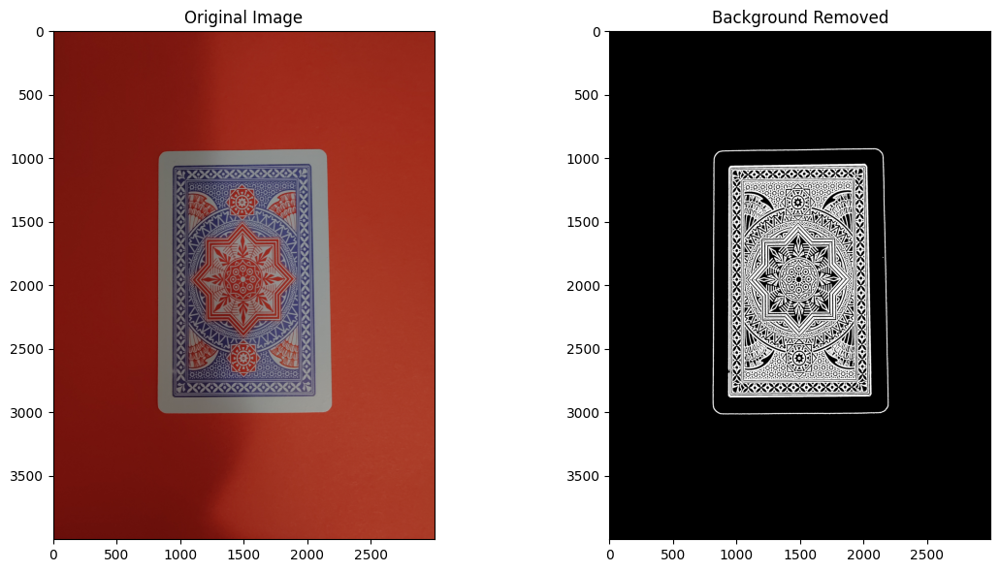

In [23]:
image = load_and_preprocess_v1("card_red_center.jpg")

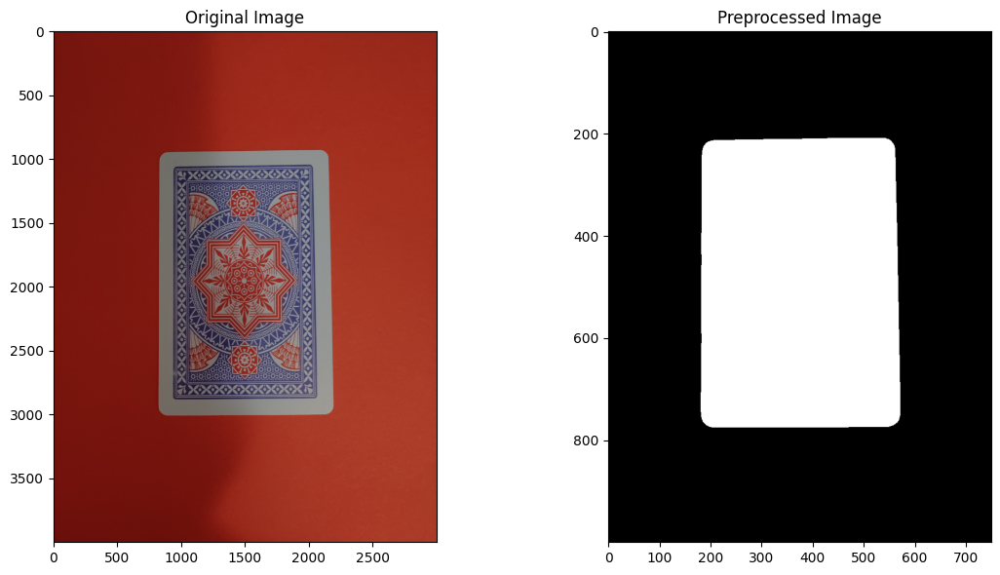

In [61]:
og_img_path = "card_red_center.jpg"
image2 = load_and_preprocess_v3(og_img_path)
original_img  = cv2.imread(og_img_path)
showImage_2(original_img,image2)

Loading and presenting 2 diffrent images that both do not have defects 

In [201]:
card_1_v3 = load_and_preprocess_v3("card_red_center.jpg")
card_2_v3 = load_and_preprocess_v3("card_red_4.jpg")

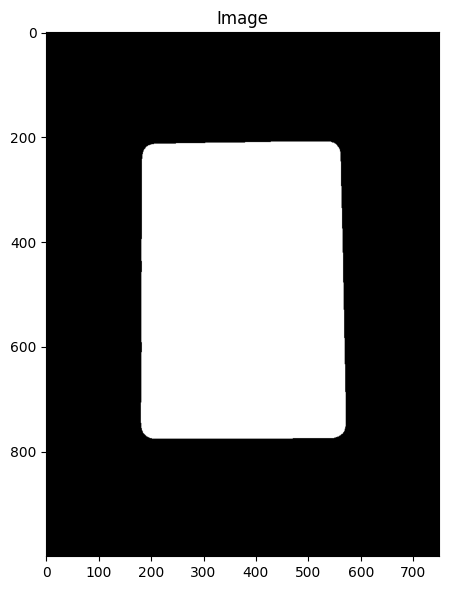

In [211]:
showImage(card_1_v3)


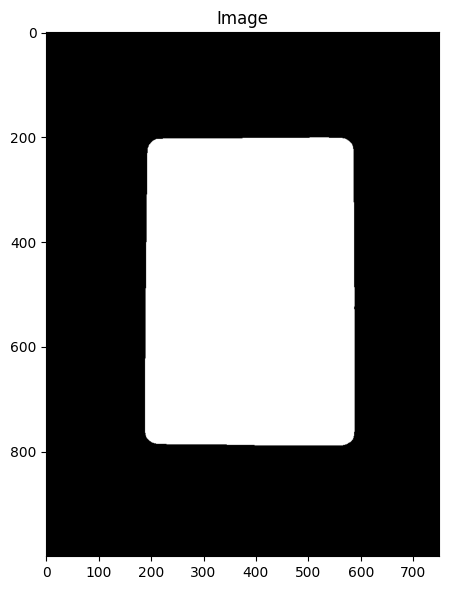

In [212]:
showImage(card_2_v3)

In [203]:
card_1_v3_features_v3 = extract_features3(card_1_v3)
card_2_v3_features_v3 = extract_features3(card_2_v3)

In [204]:
diffrences = calculate_feature_differences(card_1_v3_features_v3,card_2_v3_features_v3)

In [205]:
# Display the differences for each feature
for feature_name, diff in diffrences.items():
    print(f"{feature_name} Difference: {diff}")

Hu Moments Difference: 1.0361016873450084e-06
HOG Features Difference: 3.399031842672912
LBP Histogram Difference: 0.00023113378696004716
Mean Difference: 5.127200000000002
Standard Deviation Difference: 2.2434726532018345
Skewness Difference: 0.02463593239845918
Kurtosis Difference: 0.18323756516542966
PCA Features Difference: 3.9968028886505635e-15


In [206]:
# Defining thresholds for each feature
thresholds = {
    'Hu Moments': 1e-5,
    'HOG Features': 500,
    'LBP Histogram': 0.0004,
    'Mean': 10,
    'Standard Deviation': 5,
    'Skewness': 0.1 ,
    'Kurtosis': 1,
    'PCA Features': 5
}
detect_anomalies4(diffrences,thresholds)

False

In [210]:
detect_anomalies3(card_1_v3_features_v3,card_2_v3_features_v3,thresholds)

False

# Extracting and calculating the feature diff of all images

In [20]:
img_listx = ["card_red_center.jpg","card_red_center_drawings_big.jpg","card_red_center_drawings_small.jpg",
            "card_red_center_corner_big.jpg","card_red_center_corner_small.jpg","card_red_center_sticker.jpg",
            "card_red_tilted_1.jpg","card_red_tilted_1_drawings_big.jpg","card_red_tilted_1_drawings_small.jpg",
            "card_red_tilted_1_corner_big.jpg","card_red_tilted_1_corner_small.jpg","card_red_tilted_1_sticker.jpg",
            "card_red_1.jpg","card_red_2.jpg","card_red_4.jpg","card_red_5.jpg","card_red_tilted_2.jpg","card_red_wood.jpg"]

img_listx_labels = [0,1,1,1,1,1,0,1,1,1,1,1,0,0,0,0,0,0]

In [21]:
img_ref = load_and_preprocess_v3("card_red_center.jpg")



In [22]:
feat_ref = extract_features3(img_ref)

In [23]:
feat_ref

{'Hu Moments': 0.0007001911912344386,
 'HOG Features': 232.8029255262955,
 'LBP Histogram': 0.9923752020033308,
 'Mean': 73.83814,
 'Standard Deviation': 115.65748908453966,
 'Skewness': 0.8681539172467995,
 'Kurtosis': 1.138919179501756,
 'PCA Features': 3.1622776601683826}

In [24]:
extract_feats = []
for img in img_listx:
    img_f = preprocess_and_extract_features(img)
    extract_feats.append(img_f)
    del img_f

In [100]:
extract_feats

[{'Hu Moments': 0.0007001911912344386,
  'HOG Features': 232.8029255262955,
  'LBP Histogram': 0.9923752020033308,
  'Mean': 73.83814,
  'Standard Deviation': 115.65748908453966,
  'Skewness': 0.8681539172467995,
  'Kurtosis': 1.138919179501756,
  'PCA Features': 3.1622776601683826},
 {'Hu Moments': 0.0007004341349840701,
  'HOG Features': 233.68692905115844,
  'LBP Histogram': 0.9923752112793922,
  'Mean': 73.7851,
  'Standard Deviation': 115.63286521569033,
  'Skewness': 0.8678844385616787,
  'Kurtosis': 1.1368486373388624,
  'PCA Features': 3.1622776601683795},
 {'Hu Moments': 0.0007004341349840701,
  'HOG Features': 233.68692905115844,
  'LBP Histogram': 0.9923752112793922,
  'Mean': 73.7851,
  'Standard Deviation': 115.63286521569033,
  'Skewness': 0.8678844385616787,
  'Kurtosis': 1.1368486373388624,
  'PCA Features': 3.1622776601683795},
 {'Hu Moments': 0.0006987005424203731,
  'HOG Features': 234.77149179647427,
  'LBP Histogram': 0.9923502668361703,
  'Mean': 69.9907,
  'Stand

In [25]:
features_diff_list = []
for img_f in extract_feats:
    img_d = calculate_feature_differences(feat_ref,img_f)
    features_diff_list.append(img_d)
    del img_d

In [102]:
features_diff_list

[{'Hu Moments': 0.0,
  'HOG Features': 0.0,
  'LBP Histogram': 0.0,
  'Mean': 0.0,
  'Standard Deviation': 0.0,
  'Skewness': 0.0,
  'Kurtosis': 0.0,
  'PCA Features': 0.0},
 {'Hu Moments': 2.42943749631519e-07,
  'HOG Features': 0.8840035248629476,
  'LBP Histogram': 9.276061363472365e-09,
  'Mean': 0.05303999999999576,
  'Standard Deviation': 0.024623868849332098,
  'Skewness': 0.0002694786851207276,
  'Kurtosis': 0.002070542162893485,
  'PCA Features': 3.1086244689504383e-15},
 {'Hu Moments': 2.42943749631519e-07,
  'HOG Features': 0.8840035248629476,
  'LBP Histogram': 9.276061363472365e-09,
  'Mean': 0.05303999999999576,
  'Standard Deviation': 0.024623868849332098,
  'Skewness': 0.0002694786851207276,
  'Kurtosis': 0.002070542162893485,
  'PCA Features': 3.1086244689504383e-15},
 {'Hu Moments': 1.4906488140655578e-06,
  'HOG Features': 1.9685662701787692,
  'LBP Histogram': 2.4935167160511362e-05,
  'Mean': 3.8474399999999918,
  'Standard Deviation': 1.8641219074058881,
  'Skewne

## Finding the best threshold parameters using ML methods

In [32]:
# Split your data into training and validation sets
X_train, X_val, y_train, y_val = train_test_split(features_diff_list, img_listx_labels, test_size=0.2, random_state=42)

#### Defining thresholds ranges values then creating a list of all thresholds combinations

In [49]:
# Define all feature names
feature_list = ["Hu Moments", "HOG Features", "LBP Histogram", "Mean", 
                "Standard Deviation", "Skewness", "Kurtosis", "PCA Features"]

# Create a list of threshold ranges for each feature
threshold_ranges = {
    'Hu Moments': [1e-6, 1e-5, 1e-4, 1e-3, 1e-2],
    'HOG Features': [300, 400, 500, 600, 700],
    "LBP Histogram": [0.0003, 0.0004, 0.0005, 0.0006, 0.0007],
    "Mean": [5, 10, 15, 20, 25],
    "Standard Deviation": [2, 5, 7, 10, 12],
    "Skewness": [0.05, 0.1, 0.15, 0.2, 0.25],
    "Kurtosis": [0.5, 1, 1.5, 2, 2.5],
    "PCA Features": [3, 5, 7, 9, 11]
}


In [52]:


# Create a list of feature names
feature_names = list(threshold_ranges.keys())

# Generate all possible threshold combinations
threshold_combinations = list(itertools.product(*threshold_ranges.values()))

# Create a dictionary to store threshold combinations
thresholds_dict = {}

# Assign threshold values to feature names in the dictionary
for i, combination in enumerate(threshold_combinations):
    threshold_dict = dict(zip(feature_names, combination))
    thresholds_dict[f"Combination_{i + 1}"] = threshold_dict


In [53]:
thresholds_dict

{'Combination_1': {'Hu Moments': 1e-06,
  'HOG Features': 300,
  'LBP Histogram': 0.0003,
  'Mean': 5,
  'Standard Deviation': 2,
  'Skewness': 0.05,
  'Kurtosis': 0.5,
  'PCA Features': 3},
 'Combination_2': {'Hu Moments': 1e-06,
  'HOG Features': 300,
  'LBP Histogram': 0.0003,
  'Mean': 5,
  'Standard Deviation': 2,
  'Skewness': 0.05,
  'Kurtosis': 0.5,
  'PCA Features': 5},
 'Combination_3': {'Hu Moments': 1e-06,
  'HOG Features': 300,
  'LBP Histogram': 0.0003,
  'Mean': 5,
  'Standard Deviation': 2,
  'Skewness': 0.05,
  'Kurtosis': 0.5,
  'PCA Features': 7},
 'Combination_4': {'Hu Moments': 1e-06,
  'HOG Features': 300,
  'LBP Histogram': 0.0003,
  'Mean': 5,
  'Standard Deviation': 2,
  'Skewness': 0.05,
  'Kurtosis': 0.5,
  'PCA Features': 9},
 'Combination_5': {'Hu Moments': 1e-06,
  'HOG Features': 300,
  'LBP Histogram': 0.0003,
  'Mean': 5,
  'Standard Deviation': 2,
  'Skewness': 0.05,
  'Kurtosis': 0.5,
  'PCA Features': 11},
 'Combination_6': {'Hu Moments': 1e-06,
  'H

#### Using the first optimization version by taking all 8 features

In [67]:
# Example usage:
best_thresholds, best_f1_score = optimize_thresholds(thresholds_dict, X_val, y_val)
print("Best Thresholds:", best_thresholds)
print("Best F1 Score:", best_f1_score)

Best Thresholds: {'Hu Moments': 1e-06, 'HOG Features': 300, 'LBP Histogram': 0.0003, 'Mean': 5, 'Standard Deviation': 2, 'Skewness': 0.05, 'Kurtosis': 0.5, 'PCA Features': 3}
Best F1 Score: 0.8


#### Validating the best tresholds parameters based on the F1 score on the validation set

In [70]:
# Applying the best thresholds to the validation data
best_thresholds = {
    'Hu Moments': 1e-06,
    'HOG Features': 300,
    'LBP Histogram': 0.0003,
    'Mean': 5,
    'Standard Deviation': 2,
    'Skewness': 0.05,
    'Kurtosis': 0.5,
    'PCA Features': 3
}

# Create an empty list to store anomaly detection results on the validation data
validation_anomalies_detected = []

# Iterate over validation data and apply the anomaly detection function
for feature_diff in X_train:  
    # Apply the best thresholds to detect anomalies
    anomaly_detected = detect_anomalies4(feature_diff, best_thresholds)
    
    # Append the result (True for anomaly, False for normal) to the results list
    validation_anomalies_detected.append(anomaly_detected)
    
val_f1 = f1_score(y_train, validation_anomalies_detected)
print("F1-score:", val_f1)

# Calculate performance metrics for training data
#training_f1_score = f1_score(y_train, training_anomalies_detected, average='binary')

F1-score: 0.7058823529411764


#### Diffrent testing to manually check and compare the thresholds found to the actual feature diffrences

In [84]:
card_1_v3_feat1 = preprocess_and_extract_features("card_red_center.jpg")
card_2_v3_feat1 = preprocess_and_extract_features("card_red_tilted_1.jpg")
card_3_v3_feat1 = preprocess_and_extract_features("card_red_1.jpg")
card_4_v3_feat1 = preprocess_and_extract_features("card_red_center_corner_big.jpg")
card_5_v3_feat1 = preprocess_and_extract_features("card_red_tilted_1_corner_big.jpg")

In [85]:
card1_card2_diff = calculate_feature_differences(card_1_v3_feat1,card_2_v3_feat1)
card1_card2_diff

{'Hu Moments': 6.527675561205162e-07,
 'HOG Features': 0.8228905610302206,
 'LBP Histogram': 0.00037105328393827186,
 'Mean': 0.8340199999999953,
 'Standard Deviation': 0.3906288730045162,
 'Skewness': 0.004272588280786693,
 'Kurtosis': 0.03300334687766249,
 'PCA Features': 3.552713678800501e-15}

In [86]:
card1_card3_diff = calculate_feature_differences(card_1_v3_feat1,card_3_v3_feat1)
card1_card3_diff

{'Hu Moments': 3.3879982757820115e-07,
 'HOG Features': 1.125852761762161,
 'LBP Histogram': 4.801976673873831e-05,
 'Mean': 0.718759999999989,
 'Standard Deviation': 0.3362067104020241,
 'Skewness': 0.0036776384028582854,
 'Kurtosis': 0.028385226232318983,
 'PCA Features': 1.3322676295501878e-15}

In [87]:
card1_card4_diff = calculate_feature_differences(card_1_v3_feat1,card_4_v3_feat1)
card1_card4_diff

{'Hu Moments': 1.4906488140655578e-06,
 'HOG Features': 1.9685662701787692,
 'LBP Histogram': 2.4935167160511362e-05,
 'Mean': 3.8474399999999918,
 'Standard Deviation': 1.8641219074058881,
 'Skewness': 0.02034331225359065,
 'Kurtosis': 0.16056945666731814,
 'PCA Features': 4.440892098500626e-15}

In [88]:
card1_card5_diff = calculate_feature_differences(card_1_v3_feat1,card_5_v3_feat1)
card1_card5_diff

{'Hu Moments': 1.3135786956690407e-06,
 'HOG Features': 1.257584546614197,
 'LBP Histogram': 0.00029915161514615374,
 'Mean': 5.357379999999992,
 'Standard Deviation': 2.6398828905380896,
 'Skewness': 0.02877475209632452,
 'Kurtosis': 0.2297439920022939,
 'PCA Features': 2.220446049250313e-15}

In [ ]:
idx = 0
for feature_diff in features_diff_list:
    anomaly_detected = detect_anomalies4(feature_diff, best_thresholds)
    img_ifAnomaly = load_and_preprocess_v3(img_listx[idx])
    imageAnomality(img_listx[idx],img_ifAnomaly,anomaly_detected)
    idx = idx +1    

In [112]:
threshold_ranges_new = {
    'Hu Moments': [1e-6, 1e-5, 1e-4, 1e-3, 1e-2],
    'HOG Features': [0.6, 0.7, 0.8, 0.9, 1.0],
    "LBP Histogram": [0.0001, 0.0002, 0.0003, 0.0004, 0.0005],
    "Mean": [0.4, 0.6, 0.8, 1.0, 1.2],
    "Standard Deviation": [0.2, 0.4, 0.6, 0.8, 1.0],
    "Skewness": [0.001, 0.002, 0.005, 0.01, 0.02],
    "Kurtosis": [0.01, 0.02, 0.05, 0.1, 0.2],
    "PCA Features": [1e-16, 1e-15, 1e-14, 1e-13, 1e-12]
}


In [113]:
# Create a list of feature names
feature_names_v2 = list(threshold_ranges_new.keys())

# Generate all possible threshold combinations
threshold_combinations_v2 = list(itertools.product(*threshold_ranges_new.values()))

# Create a dictionary to store threshold combinations
thresholds_dict_v2 = {}

# Assign threshold values to feature names in the dictionary
for i, combination in enumerate(threshold_combinations_v2):
    threshold_dict = dict(zip(feature_names_v2, combination))
    thresholds_dict_v2[f"Combination_{i + 1}"] = threshold_dict


In [114]:
thresholds_dict_v2

{'Combination_1': {'Hu Moments': 1e-06,
  'HOG Features': 0.6,
  'LBP Histogram': 0.0001,
  'Mean': 0.4,
  'Standard Deviation': 0.2,
  'Skewness': 0.001,
  'Kurtosis': 0.01,
  'PCA Features': 1e-16},
 'Combination_2': {'Hu Moments': 1e-06,
  'HOG Features': 0.6,
  'LBP Histogram': 0.0001,
  'Mean': 0.4,
  'Standard Deviation': 0.2,
  'Skewness': 0.001,
  'Kurtosis': 0.01,
  'PCA Features': 1e-15},
 'Combination_3': {'Hu Moments': 1e-06,
  'HOG Features': 0.6,
  'LBP Histogram': 0.0001,
  'Mean': 0.4,
  'Standard Deviation': 0.2,
  'Skewness': 0.001,
  'Kurtosis': 0.01,
  'PCA Features': 1e-14},
 'Combination_4': {'Hu Moments': 1e-06,
  'HOG Features': 0.6,
  'LBP Histogram': 0.0001,
  'Mean': 0.4,
  'Standard Deviation': 0.2,
  'Skewness': 0.001,
  'Kurtosis': 0.01,
  'PCA Features': 1e-13},
 'Combination_5': {'Hu Moments': 1e-06,
  'HOG Features': 0.6,
  'LBP Histogram': 0.0001,
  'Mean': 0.4,
  'Standard Deviation': 0.2,
  'Skewness': 0.001,
  'Kurtosis': 0.01,
  'PCA Features': 1e-

#### Optimising new thresholds values based on new ranges on train data

In [116]:
best_thresholds_v2, best_f1_score_v2 = optimize_thresholds(thresholds_dict_v2, X_train, y_train)
print("Best Thresholds:", best_thresholds_v2)
print("Best F1 Score:", best_f1_score_v2)

Best Thresholds: {'Hu Moments': 1e-06, 'HOG Features': 0.9, 'LBP Histogram': 0.0004, 'Mean': 1.0, 'Standard Deviation': 0.4, 'Skewness': 0.005, 'Kurtosis': 0.05, 'PCA Features': 1e-16}
Best F1 Score: 0.7000000000000001


In [119]:
best_thresholds_v2

{'Hu Moments': 1e-06,
 'HOG Features': 0.9,
 'LBP Histogram': 0.0004,
 'Mean': 1.0,
 'Standard Deviation': 0.4,
 'Skewness': 0.005,
 'Kurtosis': 0.05,
 'PCA Features': 1e-16}

#### Validating the best tresholds parameters based on the F1 score on the validation set

In [118]:


# Create an empty list to store anomaly detection results on the validation data
validation_anomalies_detected_v2 = []

# Iterate over validation data and apply the anomaly detection function
for feature_diff in X_val:  
    # Apply the best thresholds to detect anomalies
    anomaly_detected_v2 = detect_anomalies4(feature_diff, best_thresholds_v2)
    
    # Append the result (True for anomaly, False for normal) to the results list
    validation_anomalies_detected_v2.append(anomaly_detected_v2)
    
val_f1_v2 = f1_score(y_val, validation_anomalies_detected_v2)
print("F1-score:", val_f1_v2)

F1-score: 1.0


In [ ]:
idx = 0
for feature_diff in features_diff_list:
    anomaly_detected = detect_anomalies4(feature_diff, best_thresholds_v2)
    img_ifAnomaly = load_and_preprocess_v3(img_listx[idx])
    imageAnomality(img_listx[idx],img_ifAnomaly,anomaly_detected)
    idx = idx +1    

In [129]:
threshold_v3 = {'Hu Moments': 1e-06,
 'HOG Features': 1.2,
 'LBP Histogram': 0.0004,
 'Mean': 1.0,
 'Standard Deviation': 0.5,
 'Skewness': 0.005,
 'Kurtosis': 0.05,
 'PCA Features': 1e-15}

In [ ]:
idx = 0
for feature_diff in features_diff_list:
    anomaly_detected = detect_anomalies4(feature_diff, threshold_v3)
    img_ifAnomaly = load_and_preprocess_v3(img_listx[idx])
    imageAnomality(img_listx[idx],img_ifAnomaly,anomaly_detected)
    idx = idx +1    

#### Optimisation of thresholds v3

In [135]:
threshold_ranges_v3 = {
    'Hu Moments': [1e-7, 5e-7, 1e-6, 5e-6, 1e-5],
    'HOG Features': [0.8, 0.9, 1.0, 1.1, 1.2, 1.3, 1.4, 1.5],
    "LBP Histogram": [0.0003, 0.0004, 0.0005, 0.0006, 0.0007 , 0.00009, 0.00005],
    "Mean": [0.8, 1.0, 1.2],
    "Standard Deviation": [0.2, 0.4, 0.6, 0.8, 1.0],
    "Skewness": [0.002, 0.005, 0.01, 0.02],
    "Kurtosis": [0.02, 0.05, 0.1, 0.2],
    "PCA Features": [1e-16, 5e-16, 1e-15, 5e-15, 1e-14]
}

In [136]:
# Create a list of feature names
feature_names_v3 = list(threshold_ranges_v3.keys())

# Generate all possible threshold combinations
threshold_combinations_v3 = list(itertools.product(*threshold_ranges_v3.values()))

# Create a dictionary to store threshold combinations
thresholds_dict_v3 = {}

# Assign threshold values to feature names in the dictionary
for i, combination in enumerate(threshold_combinations_v3):
    threshold_dict = dict(zip(feature_names_v3, combination))
    thresholds_dict_v3[f"Combination_{i + 1}"] = threshold_dict

In [137]:
best_thresholds_v3, best_f1_score_v3 = optimize_thresholds(thresholds_dict_v3, X_train, y_train)
print("Best Thresholds:", best_thresholds_v3)
print("Best F1 Score:", best_f1_score_v3)

Best Thresholds: {'Hu Moments': 5e-07, 'HOG Features': 1.2, 'LBP Histogram': 0.0003, 'Mean': 0.8, 'Standard Deviation': 0.4, 'Skewness': 0.005, 'Kurtosis': 0.05, 'PCA Features': 5e-16}
Best F1 Score: 0.7000000000000001


In [138]:
best_thresholds_v3

{'Hu Moments': 5e-07,
 'HOG Features': 1.2,
 'LBP Histogram': 0.0003,
 'Mean': 0.8,
 'Standard Deviation': 0.4,
 'Skewness': 0.005,
 'Kurtosis': 0.05,
 'PCA Features': 5e-16}

#### Validating the thresholds found v3

In [139]:

# Create an empty list to store anomaly detection results on the validation data
validation_anomalies_detected_v3 = []

# Iterate over validation data and apply the anomaly detection function
for feature_diff in X_val:  
    # Apply the best thresholds to detect anomalies
    anomaly_detected_v3 = detect_anomalies4(feature_diff, best_thresholds_v3)
    
    # Append the result (True for anomaly, False for normal) to the results list
    validation_anomalies_detected_v3.append(anomaly_detected_v3)
    
val_f1_v3 = f1_score(y_val, validation_anomalies_detected_v3)
print("F1-score:", val_f1_v3)

F1-score: 1.0


#### Testing new found thresholds all all images

In [143]:
thresholds_new_v3 = {'Hu Moments': 5e-07,
 'HOG Features': 1.2,
 'LBP Histogram': 0.0003,
 'Mean': 0.8,
 'Standard Deviation': 0.4,
 'Skewness': 0.005,
 'Kurtosis': 0.05,
 'PCA Features': 5e-16}

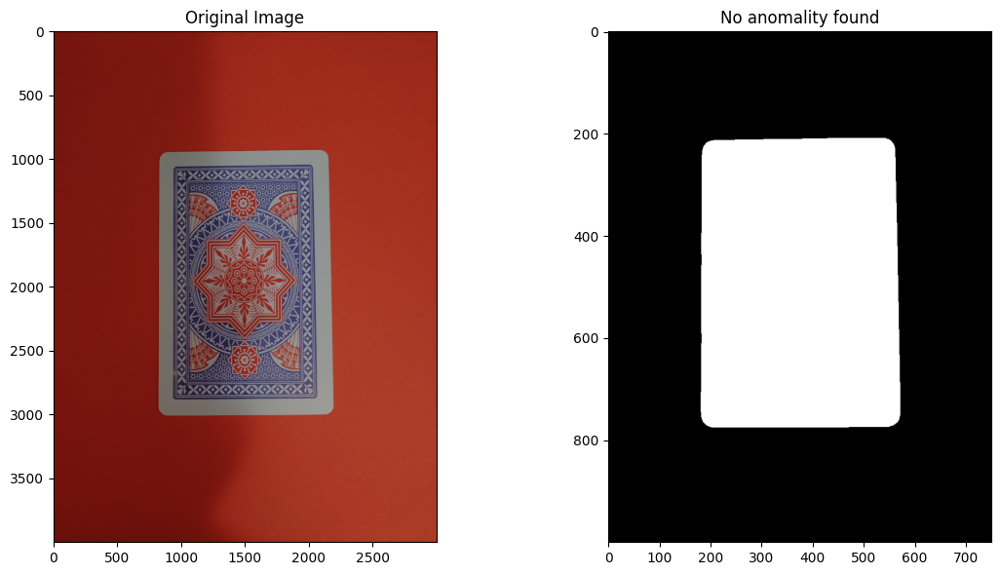

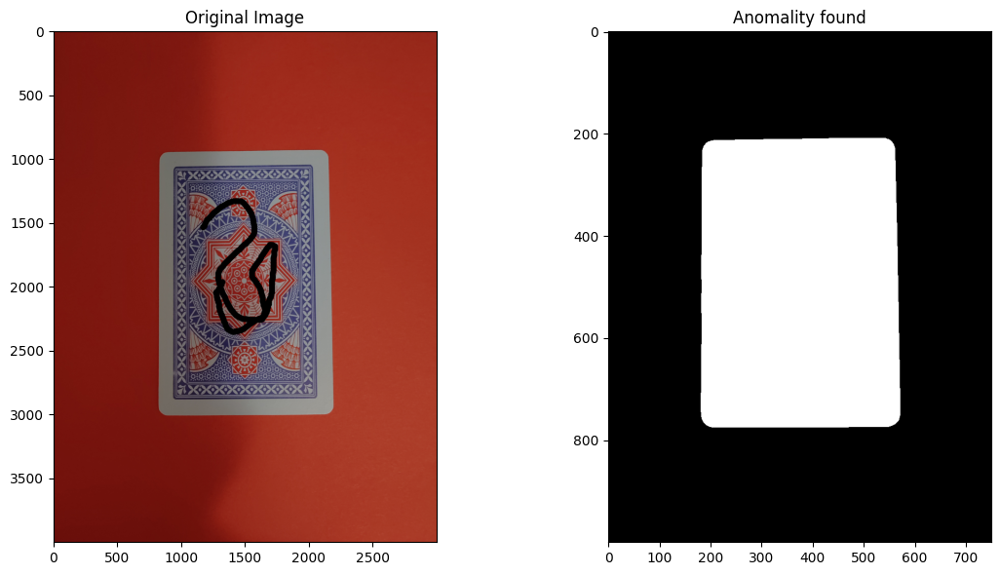

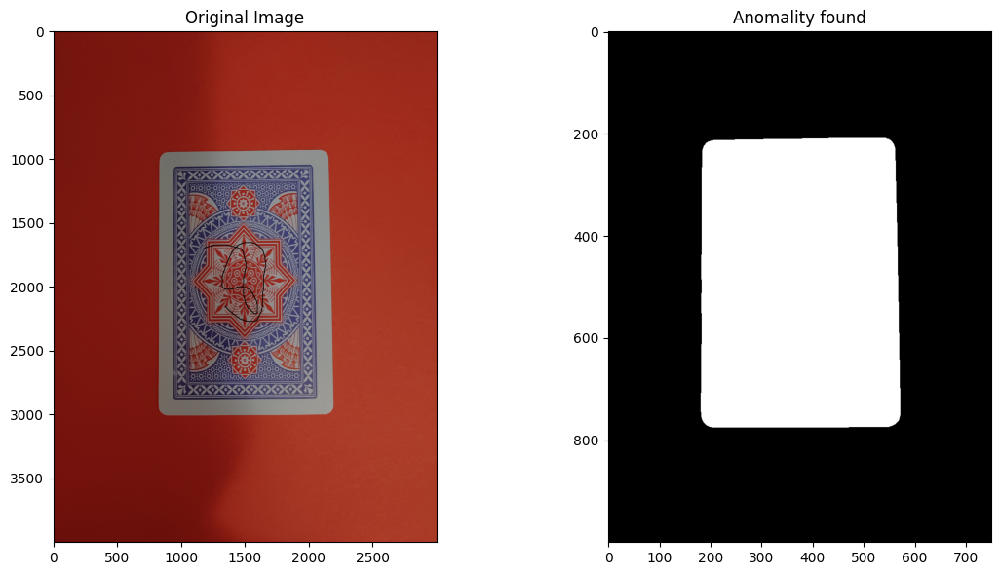

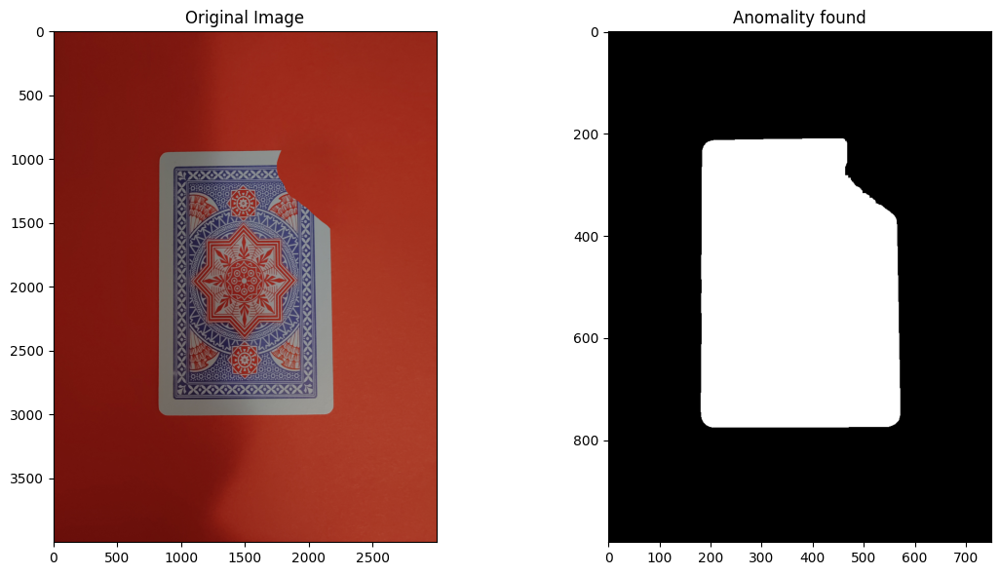

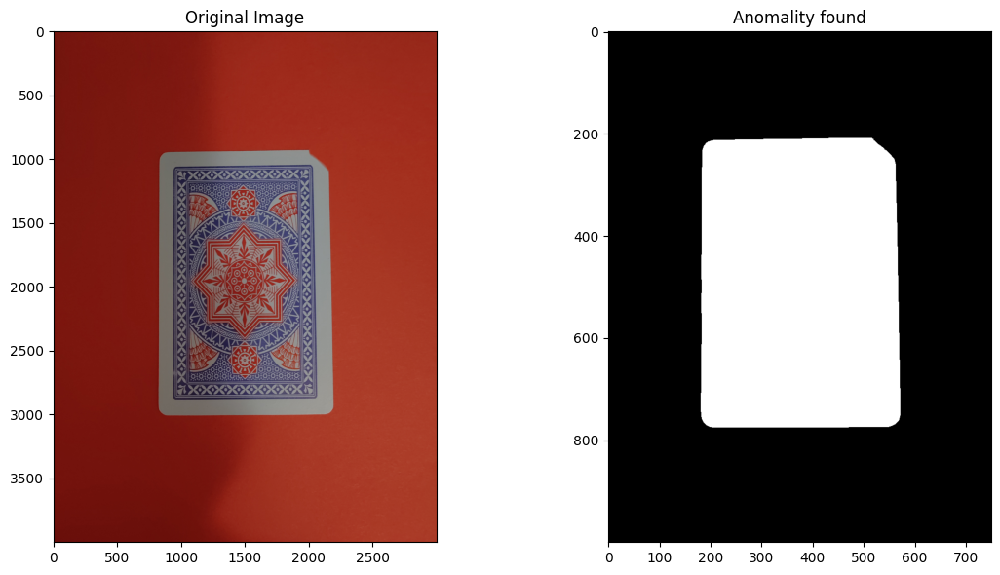

...

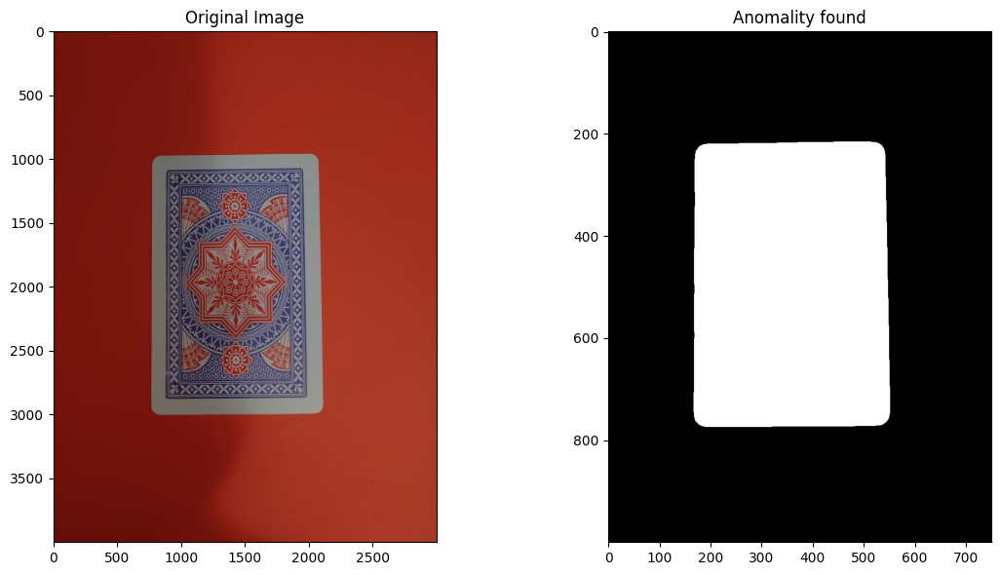

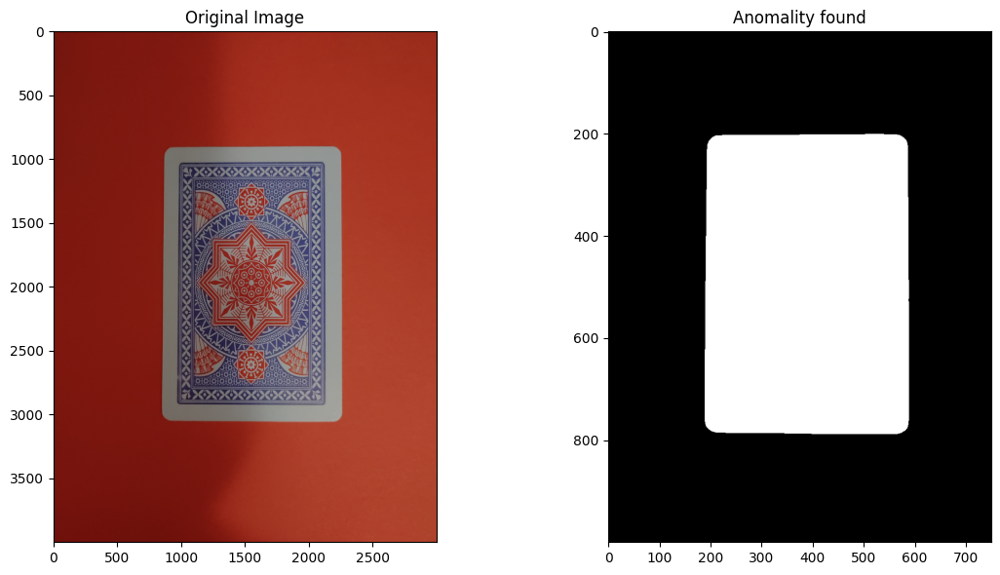

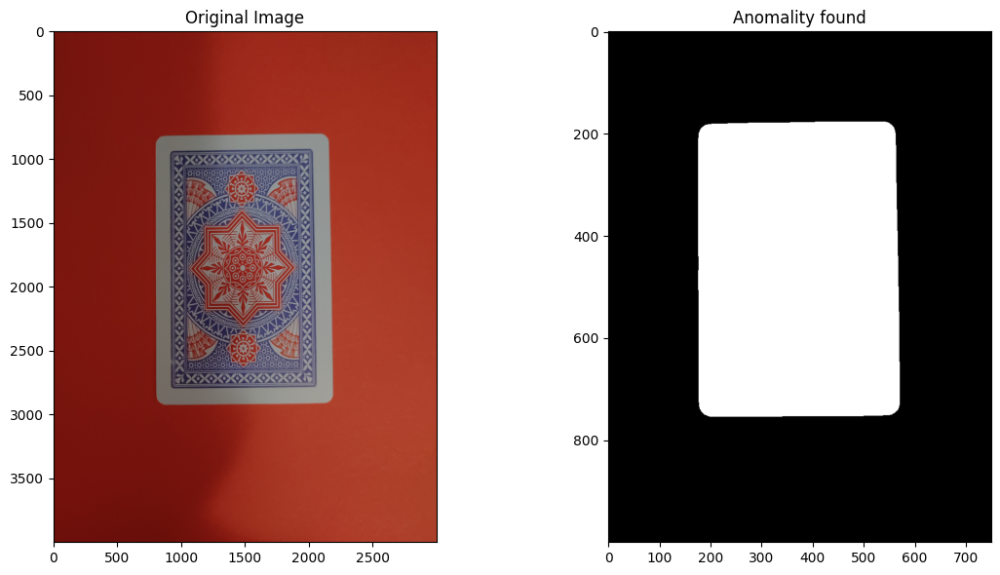

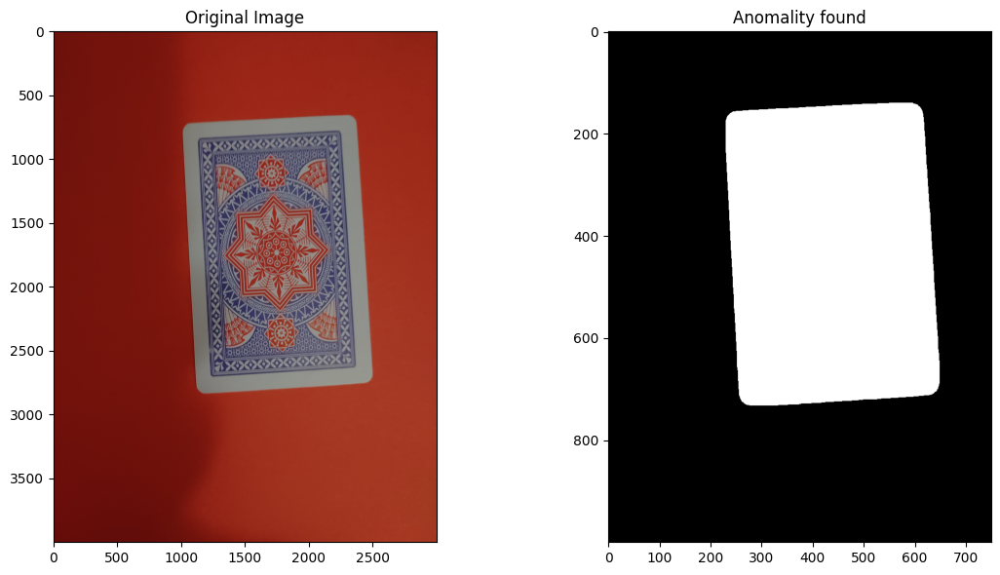

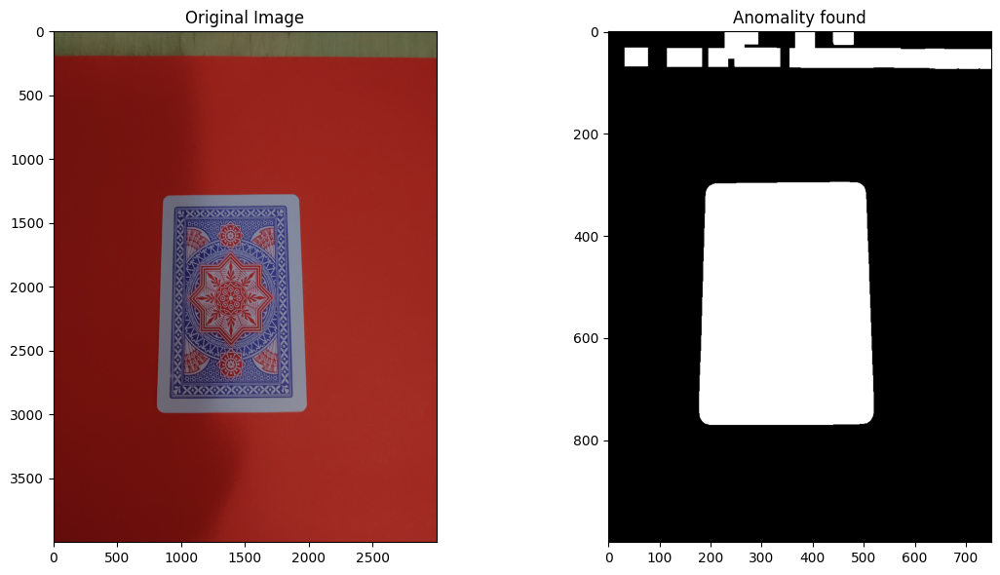

In [141]:
idx = 0
for feature_diff in features_diff_list:
    anomaly_detected = detect_anomalies4(feature_diff, thresholds_new_v3)
    img_ifAnomaly = load_and_preprocess_v3(img_listx[idx])
    imageAnomality(img_listx[idx],img_ifAnomaly,anomaly_detected)
    idx = idx +1    

#### New thresholds with manual changes

In [150]:
thresholds_v4 = {'Hu Moments': 1e-06,
 'HOG Features': 3.0,
 'LBP Histogram': 0.0004,
 'Mean': 1,
 'Standard Deviation': 1.5,
 'Skewness': 0.05,
 'Kurtosis': 0.2,
 'PCA Features': 1e-16}

In [ ]:
idx = 0
for feature_diff in features_diff_list:
    anomaly_detected = detect_anomalies4(feature_diff, thresholds_v4)
    img_ifAnomaly = load_and_preprocess_v3(img_listx[idx])
    imageAnomality(img_listx[idx],img_ifAnomaly,anomaly_detected)
    idx = idx +1    

### Best results

#### Same thresholds but run without the statistic features

In [111]:
thresholds_noStatistics = {'Hu Moments': 1e-06,
 'HOG Features': 3,
 'LBP Histogram': 0.0005,
 'PCA Features': 4e-15}

In [105]:
features_diff_list

[{'Hu Moments': 0.0,
  'HOG Features': 0.0,
  'LBP Histogram': 0.0,
  'Mean': 0.0,
  'Standard Deviation': 0.0,
  'Skewness': 0.0,
  'Kurtosis': 0.0,
  'PCA Features': 0.0},
 {'Hu Moments': 2.42943749631519e-07,
  'HOG Features': 0.8840035248629476,
  'LBP Histogram': 9.276061363472365e-09,
  'Mean': 0.05303999999999576,
  'Standard Deviation': 0.024623868849332098,
  'Skewness': 0.0002694786851207276,
  'Kurtosis': 0.002070542162893485,
  'PCA Features': 3.1086244689504383e-15},
 {'Hu Moments': 2.42943749631519e-07,
  'HOG Features': 0.8840035248629476,
  'LBP Histogram': 9.276061363472365e-09,
  'Mean': 0.05303999999999576,
  'Standard Deviation': 0.024623868849332098,
  'Skewness': 0.0002694786851207276,
  'Kurtosis': 0.002070542162893485,
  'PCA Features': 3.1086244689504383e-15},
 {'Hu Moments': 1.4906488140655578e-06,
  'HOG Features': 1.9685662701787692,
  'LBP Histogram': 2.4935167160511362e-05,
  'Mean': 3.8474399999999918,
  'Standard Deviation': 1.8641219074058881,
  'Skewne

In [85]:
features_diff_list[0]

{'Hu Moments': 0.0,
 'HOG Features': 0.0,
 'LBP Histogram': 0.0,
 'Mean': 0.0,
 'Standard Deviation': 0.0,
 'Skewness': 0.0,
 'Kurtosis': 0.0,
 'PCA Features': 1.3322676295501878e-15}

In [ ]:
idx = 0
anomalies_found_in_images = []
anomalies_list = []
for feature_diff in features_diff_list:
    a,anomaly_detected = detect_anomalies5(feature_diff, thresholds_noStatistics)
    anomalies_list.append(anomaly_detected)
    anomalies_found_in_images.append(a)
    img_ifAnomaly = load_and_preprocess_v3(img_listx[idx])
    imageAnomality(img_listx[idx],img_ifAnomaly,anomaly_detected)
    idx = idx +1    

In [109]:
anomalies_list

[False,
 False,
 False,
 True,
 True,
 True,
 True,
 False,
 False,
 True,
 True,
 False,
 False,
 True,
 True,
 False,
 False,
 True]

In [110]:
anomalies_found_in_images

[[],
 [],
 [],
 ['Hu Moments', 'PCA Features'],
 ['Hu Moments'],
 ['Hu Moments', 'HOG Features'],
 ['PCA Features'],
 [],
 [],
 ['Hu Moments'],
 ['Hu Moments', 'PCA Features'],
 [],
 [],
 ['PCA Features'],
 ['Hu Moments', 'HOG Features', 'PCA Features'],
 [],
 [],
 ['Hu Moments', 'HOG Features', 'LBP Histogram']]

In [164]:
anomalies_found_in_images

[[],
 ['PCA Features'],
 ['PCA Features'],
 ['Hu Moments'],
 ['Hu Moments'],
 ['Hu Moments', 'HOG Features', 'PCA Features'],
 [],
 [],
 ['PCA Features'],
 ['Hu Moments', 'PCA Features'],
 ['Hu Moments'],
 [],
 [],
 ['PCA Features'],
 ['Hu Moments', 'PCA Features'],
 [],
 ['PCA Features'],
 ['Hu Moments', 'HOG Features', 'LBP Histogram', 'PCA Features']]

#### Threshold optimisation v4

In [53]:
# Split your data into training and validation sets
X_train_v4, X_val_v4, y_train_v4, y_val_v4 = train_test_split(features_diff_list, img_listx_labels, test_size=0.3, random_state=42)

In [187]:
threshold_ranges_v4 = {
    'Hu Moments': [1e-7, 5e-7, 1e-6, 2e-6, 3e-6, 4e-6, 5e-6, 1e-5],
    'HOG Features': [0.8, 0.9, 1.0, 1.1, 1.2, 1.3, 1.4, 1.5],
    "LBP Histogram": [0.0002,0.00025,0.0003,0.00032,0.00035,0.00037, 0.0004, 0.0005, 0.0006, 0.0007 , 0.00009, 0.00005],
    "PCA Features": [1e-16,2e-16,3e-16,4e-16, 5e-16, 1e-15, 5e-15, 1e-14]
}

In [188]:
thresholds_dict_v4 = thresholds_dicts(threshold_ranges_v4)

In [190]:
best_thresholds_v4, best_f1_score_v4 = optimize_thresholds_v2(thresholds_dict_v4, X_train_v4, y_train_v4)
print("Best Thresholds:", best_thresholds_v4)
print("Best F1 Score:", best_f1_score_v4)

Best Thresholds: {'Hu Moments': 5e-07, 'HOG Features': 1.2, 'LBP Histogram': 0.0002, 'PCA Features': 5e-16}
Best F1 Score: 0.7058823529411764


#### Validatin the thresholds found v4

In [192]:
# Create an empty list to store anomaly detection results on the validation data
validation_anomalies_detected_v4 = []

# Iterate over validation data and apply the anomaly detection function
for feature_diff in X_val_v4:  
    # Apply the best thresholds to detect anomalies
    a,anomaly_detected_v4 = detect_anomalies5(feature_diff, best_thresholds_v4)
    
    # Append the result (True for anomaly, False for normal) to the results list
    validationanomalies_detected_v4.append(anomaly_detected_v4)
    
val_f1_v4 = f1_score(y_val_v4, validation_anomalies_detected_v4)
print("F1-score:", val_f1_v4)

F1-score: 0.888888888888889


#### Trying  the thresholds on all the images

In [ ]:
idx = 0
anomalities_in_imgs_v4 = []
for feature_diff in features_diff_list:
    a5,anomaly_detected = detect_anomalies5(feature_diff, best_thresholds_v4)
    anomalities_in_imgs_v4.append(a5)
    img_ifAnomaly = load_and_preprocess_v3(img_listx[idx])
    imageAnomality(img_listx[idx],img_ifAnomaly,anomaly_detected)
    idx = idx +1    

In [200]:
anomalities_in_imgs_v4

[[],
 ['PCA Features'],
 ['PCA Features'],
 ['Hu Moments', 'HOG Features'],
 ['Hu Moments'],
 ['Hu Moments', 'HOG Features', 'LBP Histogram', 'PCA Features'],
 ['Hu Moments', 'LBP Histogram'],
 ['Hu Moments', 'LBP Histogram'],
 ['Hu Moments', 'LBP Histogram', 'PCA Features'],
 ['Hu Moments', 'HOG Features', 'LBP Histogram', 'PCA Features'],
 ['Hu Moments', 'LBP Histogram'],
 ['Hu Moments', 'LBP Histogram'],
 [],
 ['HOG Features', 'PCA Features'],
 ['Hu Moments', 'HOG Features', 'LBP Histogram', 'PCA Features'],
 ['Hu Moments', 'HOG Features'],
 ['HOG Features', 'LBP Histogram', 'PCA Features'],
 ['Hu Moments', 'HOG Features', 'LBP Histogram', 'PCA Features']]

#### Threhold optimisation v5

In [201]:
threshold_ranges_v5 = {
    'Hu Moments': [1e-6, 1.2e-6, 1.4e-6, 1.5e-6, 1.6e-6, 1.8e-6, 2e-6, 2.2e-6, 2.4e-6, 2.5e-6, 2.6e-6,
                    2.8e-6,3e-6,3.2e-6,3.4e-6,3.5e-6,3.6e-6,3.8e-6, 4e-6,4.2e-6,4.4e-6,4.5e-6,4.6e-6,4.8e-6,
                   5e-6,5.2e-6,5.4e-6,5.5e-6,5.6e-6,5.8e-6,6e-6, 1e-5],
    'HOG Features': [0.8, 0.9, 1.0, 1.1, 1.2, 1.3, 1.4, 1.5],
    "LBP Histogram": [0.0002,0.00025,0.0003,0.00032,0.00035,0.00037, 0.0004, 0.0005, 0.0006, 0.0007 , 0.00009, 0.00005],
    "PCA Features": [1e-16,2e-16,3e-16,4e-16, 5e-16, 6e-16, 7e-16, 8e-16, 9e-16, 1e-15, 5e-15, 1e-14]
}

In [202]:
thresholds_dict_v5 = thresholds_dicts(threshold_ranges_v5)

In [203]:
best_thresholds_v5, best_f1_score_v5 = optimize_thresholds_v2(thresholds_dict_v5, X_train_v4, y_train_v4)
print("Best Thresholds:", best_thresholds_v5)
print("Best F1 Score:", best_f1_score_v5)

Best Thresholds: {'Hu Moments': 1e-06, 'HOG Features': 0.9, 'LBP Histogram': 0.0004, 'PCA Features': 1e-16}
Best F1 Score: 0.7058823529411764


In [204]:
best_thresholds_v5

{'Hu Moments': 1e-06,
 'HOG Features': 0.9,
 'LBP Histogram': 0.0004,
 'PCA Features': 1e-16}

#### Validating the thresholds

In [207]:
# Create an empty list to store anomaly detection results on the validation data
validation_anomalies_detected_v5 = []

# Iterate over validation data and apply the anomaly detection function
for feature_diff in X_val_v4:  
    # Apply the best thresholds to detect anomalies
    a,anomaly_detected_v5 = detect_anomalies5(feature_diff, best_thresholds_v5)
    
    # Append the result (True for anomaly, False for normal) to the results list
    validation_anomalies_detected_v5.append(anomaly_detected_v5)
    
val_f1_v5 = f1_score(y_val_v4, validation_anomalies_detected_v5)
print("F1-score:", val_f1_v5)

F1-score: 0.888888888888889


#### Trying the best tresholds found on all the images

In [ ]:
idx = 0
anomalities_in_imgs_v5 = []
for feature_diff in features_diff_list:
    a5,anomaly_detected = detect_anomalies5(feature_diff, best_thresholds_v5)
    anomalities_in_imgs_v5.append(a5)
    img_ifAnomaly = load_and_preprocess_v3(img_listx[idx])
    imageAnomality(img_listx[idx],img_ifAnomaly,anomaly_detected)
    idx = idx +1    

In [209]:
anomalities_in_imgs_v5

[[],
 ['PCA Features'],
 ['PCA Features'],
 ['Hu Moments', 'HOG Features', 'PCA Features'],
 ['Hu Moments', 'PCA Features'],
 ['Hu Moments', 'HOG Features', 'PCA Features'],
 [],
 ['PCA Features'],
 ['PCA Features'],
 ['Hu Moments', 'HOG Features', 'PCA Features'],
 ['Hu Moments', 'PCA Features'],
 ['PCA Features'],
 ['HOG Features', 'PCA Features'],
 ['HOG Features', 'PCA Features'],
 ['Hu Moments', 'HOG Features', 'PCA Features'],
 ['HOG Features'],
 ['HOG Features', 'LBP Histogram', 'PCA Features'],
 ['Hu Moments', 'HOG Features', 'LBP Histogram', 'PCA Features']]

In [215]:
thresholds_dict_v5

{'Combination_1': {'Hu Moments': 1e-06,
  'HOG Features': 0.8,
  'LBP Histogram': 0.0002,
  'PCA Features': 1e-16},
 'Combination_2': {'Hu Moments': 1e-06,
  'HOG Features': 0.8,
  'LBP Histogram': 0.0002,
  'PCA Features': 2e-16},
 'Combination_3': {'Hu Moments': 1e-06,
  'HOG Features': 0.8,
  'LBP Histogram': 0.0002,
  'PCA Features': 3e-16},
 'Combination_4': {'Hu Moments': 1e-06,
  'HOG Features': 0.8,
  'LBP Histogram': 0.0002,
  'PCA Features': 4e-16},
 'Combination_5': {'Hu Moments': 1e-06,
  'HOG Features': 0.8,
  'LBP Histogram': 0.0002,
  'PCA Features': 5e-16},
 'Combination_6': {'Hu Moments': 1e-06,
  'HOG Features': 0.8,
  'LBP Histogram': 0.0002,
  'PCA Features': 6e-16},
 'Combination_7': {'Hu Moments': 1e-06,
  'HOG Features': 0.8,
  'LBP Histogram': 0.0002,
  'PCA Features': 7e-16},
 'Combination_8': {'Hu Moments': 1e-06,
  'HOG Features': 0.8,
  'LBP Histogram': 0.0002,
  'PCA Features': 8e-16},
 'Combination_9': {'Hu Moments': 1e-06,
  'HOG Features': 0.8,
  'LBP Hi

Trying to use cross-validation to see if can get better results

In [218]:
from sklearn.model_selection import KFold
# Defining the number of folds for cross-validation
num_folds = 5

for train_index, val_index in kf.split(features_diff_list, img_listx_labels):
    # Convert data to NumPy arrays and then index them
    X_train_fold, X_val_fold = np.array(features_diff_list)[train_index], np.array(features_diff_list)[val_index]
    y_train_fold, y_val_fold = np.array(img_listx_labels)[train_index], np.array(img_listx_labels)[val_index]

    # Define a range of threshold values to explore
    threshold_values = thresholds_dict_v5

    best_f1_score = 0.0
    best_threshold = None

    # Iterate over threshold values
    for t,threshold in threshold_values.items():
        anomalies_detected = []

        # Apply the threshold to detect anomalies on the validation set
        for feature_diff in X_val_fold:
            _,anomaly_detected = detect_anomalies5(feature_diff, threshold)
            anomalies_detected.append(anomaly_detected)

        # Calculate the F1 score for this threshold
        f1 = f1_score(y_val_fold, anomalies_detected, average='binary')

        # Update best threshold if F1 score is higher
        if f1 > best_f1_score:
            best_f1_score = f1
            best_threshold = threshold

    # Store the best threshold and F1 score for this fold
    best_thresholds_per_fold.append(best_threshold)
    best_f1_scores_per_fold.append(best_f1_score)

# Calculate the overall best threshold and its corresponding F1 score
best_f1_score_overall = max(best_f1_scores_per_fold)
best_threshold_overall = best_thresholds_per_fold[best_f1_scores_per_fold.index(best_f1_score_overall)]

print("Best Threshold (Overall):", best_threshold_overall)
print("Best F1 Score (Overall):", best_f1_score_overall)



Best Threshold (Overall): {'Hu Moments': 1e-06, 'HOG Features': 0.8, 'LBP Histogram': 0.0002, 'PCA Features': 1e-16}
Best F1 Score (Overall): 1.0


In [219]:
best_threshold_overall

{'Hu Moments': 1e-06,
 'HOG Features': 0.8,
 'LBP Histogram': 0.0002,
 'PCA Features': 1e-16}

In [ ]:
idx = 0
anomalities_in_imgs_v6 = []
for feature_diff in features_diff_list:
    a5,anomaly_detected = detect_anomalies5(feature_diff, best_threshold_overall)
    anomalities_in_imgs_v6.append(a5)
    img_ifAnomaly = load_and_preprocess_v3(img_listx[idx])
    imageAnomality(img_listx[idx],img_ifAnomaly,anomaly_detected)
    idx = idx +1    

In [140]:
thresholds_noStatistics_test = {'Hu Moments': 1e-06,
 'HOG Features': 1.1,
 'LBP Histogram': 0.0005,
 'PCA Features': 4e-15}

In [ ]:
idx = 0
anomalities_in_imgs_test = []
for feature_diff in features_diff_list:
    a5,anomaly_detected = detect_anomalies5(feature_diff, thresholds_noStatistics_test)
    anomalities_in_imgs_test.append(a5)
    img_ifAnomaly = load_and_preprocess_v3(img_listx[idx])
    imageAnomality(img_listx[idx],img_ifAnomaly,anomaly_detected)
    idx = idx +1    

In [142]:
# Create an empty list to store anomaly detection results on the validation data
validation_anomalies_detected = []

# Iterate over training data and apply the anomaly detection function
for feature_diff in X_val_v4:  
    # Apply the best thresholds to detect anomalies
    a,anomaly_detected_test = detect_anomalies5(feature_diff, thresholds_noStatistics_test)
    
    # Append the result (True for anomaly, False for normal) to the results list
    validation_anomalies_detected.append(anomaly_detected_test)
    
val_f1_test = f1_score(y_val_v4, validation_anomalies_detected)
print("F1-score:", val_f1_test)

F1-score: 0.5714285714285715


In [143]:
y_val_v4

[0, 1, 1, 1, 1, 0]

In [144]:
y_train_v4

[0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0]

## Trying new Approach

Trying with wider ranges, diffrent labels and parameters to see if i can incease the accuracy.

In [145]:
img_labels_new = [0,0,0,1,1,0,0,0,0,1,1,0,0,0,0,0,0,0] # This time i only define the images that are torn as anomalies

In [146]:
# Split your data into training and validation sets
X_train_v6, X_val_v6, y_train_v6, y_val_v6 = train_test_split(features_diff_list, 
                                                              img_labels_new, test_size=0.2, random_state=42)

In [214]:
# Calcuationg features statistics info to better understand and make better thresholds ranges
feature_stats = calculate_feature_statistics(features_diff_list[1:-1])
feature_stats

{'Hu Moments': {'Min': 1.2356949898430572e-08,
  'Max': 5.005431439965334e-06,
  'Mean': 1.005739725294407e-06,
  'Std Deviation': 1.123472546022254e-06},
 'HOG Features': {'Min': 0.6683510904549621,
  'Max': 4.198612137549333,
  'Mean': 1.6454190572949603,
  'Std Deviation': 1.0708315476598391},
 'LBP Histogram': {'Min': 9.276061363472365e-09,
  'Max': 0.0004179483575463827,
  'Mean': 0.00021123818360865854,
  'Std Deviation': 0.00015766826537433679},
 'Mean': {'Min': 0.05303999999999576,
  'Max': 5.357379999999992,
  'Mean': 1.8030412499999962,
  'Std Deviation': 1.7109422390231181},
 'Standard Deviation': {'Min': 0.024623868849332098,
  'Max': 2.6398828905380896,
  'Mean': 0.8412841180203534,
  'Std Deviation': 0.8015954195554004},
 'Skewness': {'Min': 0.0002694786851207276,
  'Max': 0.02877475209632452,
  'Mean': 0.009202080082395835,
  'Std Deviation': 0.00876309551209567},
 'Kurtosis': {'Min': 0.002070542162893485,
  'Max': 0.2297439920022939,
  'Mean': 0.07107812755088266,
  'St

In [104]:
threshold_ranges_v6 = {
    'Hu Moments': [1.3e-8, 1e-7,5e-7, 1e-6, 5e-6, 1e-5,5e-5,1e-4],
    'HOG Features': [0.67, 0.7, 0.75,0.8,0.85,0.9 ,1.0, 1.1, 1.2],
    "LBP Histogram": [0.00000001,0.0000001,0.000001,0.00001, 0.0002, 0.0004,0.00045, 0.0005],
    "Mean": [0.05,0.1, 0.5 , 0.7, 0.8, 0.9, 1.0, 1.2,6],
    "Standard Deviation": [0.001,0.002,0.005,0.01, 0.2, 0.4, 0.6, 0.8, 1.0,3],
    "Skewness": [0.0001,0.003,0.005,0.002, 0.005, 0.01, 0.02,0.03],
    "Kurtosis": [0.01,0.0025, 0.005, 0.01, 0.03, 0.05,0.7, 0.1, 0.2,0.3],
   
}

In [105]:
thresholds_dict_v6 = thresholds_dicts(threshold_ranges_v6)

In [112]:
thresholds_dict_v6

{'Combination_1': {'Hu Moments': 1.3e-08,
  'HOG Features': 0.67,
  'LBP Histogram': 1e-08,
  'Mean': 0.05,
  'Standard Deviation': 0.001,
  'Skewness': 0.0001,
  'Kurtosis': 0.01},
 'Combination_2': {'Hu Moments': 1.3e-08,
  'HOG Features': 0.67,
  'LBP Histogram': 1e-08,
  'Mean': 0.05,
  'Standard Deviation': 0.001,
  'Skewness': 0.0001,
  'Kurtosis': 0.0025},
 'Combination_3': {'Hu Moments': 1.3e-08,
  'HOG Features': 0.67,
  'LBP Histogram': 1e-08,
  'Mean': 0.05,
  'Standard Deviation': 0.001,
  'Skewness': 0.0001,
  'Kurtosis': 0.005},
 'Combination_4': {'Hu Moments': 1.3e-08,
  'HOG Features': 0.67,
  'LBP Histogram': 1e-08,
  'Mean': 0.05,
  'Standard Deviation': 0.001,
  'Skewness': 0.0001,
  'Kurtosis': 0.01},
 'Combination_5': {'Hu Moments': 1.3e-08,
  'HOG Features': 0.67,
  'LBP Histogram': 1e-08,
  'Mean': 0.05,
  'Standard Deviation': 0.001,
  'Skewness': 0.0001,
  'Kurtosis': 0.03},
 'Combination_6': {'Hu Moments': 1.3e-08,
  'HOG Features': 0.67,
  'LBP Histogram': 1e

In [88]:
X_train_v6

[{'Hu Moments': 2.547161012102185e-07,
  'HOG Features': 2.8276493594423187,
  'LBP Histogram': 0.0004179483575463827,
  'Mean': 3.2286399999999986,
  'Standard Deviation': 1.4439213272552536,
  'Skewness': 0.015837007013038584,
  'Kurtosis': 0.11914022507149125,
  'PCA Features': 3.1086244689504383e-15},
 {'Hu Moments': 8.128780740341559e-07,
  'HOG Features': 2.6898866845485827,
  'LBP Histogram': 0.0001115882836495441,
  'Mean': 2.5228000000000037,
  'Standard Deviation': 1.1374018239089452,
  'Skewness': 0.012469348770207334,
  'Kurtosis': 0.09421782371251641,
  'PCA Features': 1.7763568394002505e-15},
 {'Hu Moments': 7.079295140684358e-07,
  'HOG Features': 0.8378594436788376,
  'LBP Histogram': 0.0003710489434546327,
  'Mean': 0.8248399999999947,
  'Standard Deviation': 0.3862891987486279,
  'Skewness': 0.0042251500399470565,
  'Kurtosis': 0.032634853597547364,
  'PCA Features': 3.1086244689504383e-15},
 {'Hu Moments': 2.42943749631519e-07,
  'HOG Features': 0.8840035248629476,
 

In [107]:
best_thresholds_v6, best_f1_score_v6 = optimize_thresholds_v3(thresholds_dict_v6, X_train_v6, y_train_v6)
print("Best Thresholds:", best_thresholds_v6)
print("Best F1 Score:", best_f1_score_v6)

Best Thresholds: {'Hu Moments': 1.3e-08, 'HOG Features': 0.67, 'LBP Histogram': 1e-08, 'Mean': 0.05, 'Standard Deviation': 0.001, 'Skewness': 0.0001, 'Kurtosis': 0.01}
Best F1 Score: 0.6666666666666666


In [131]:
y_train_v6

[1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0]

In [114]:
X_train_v6

[{'Hu Moments': 2.547161012102185e-07,
  'HOG Features': 2.8276493594423187,
  'LBP Histogram': 0.0004179483575463827,
  'Mean': 3.2286399999999986,
  'Standard Deviation': 1.4439213272552536,
  'Skewness': 0.015837007013038584,
  'Kurtosis': 0.11914022507149125,
  'PCA Features': 3.1086244689504383e-15},
 {'Hu Moments': 8.128780740341559e-07,
  'HOG Features': 2.6898866845485827,
  'LBP Histogram': 0.0001115882836495441,
  'Mean': 2.5228000000000037,
  'Standard Deviation': 1.1374018239089452,
  'Skewness': 0.012469348770207334,
  'Kurtosis': 0.09421782371251641,
  'PCA Features': 1.7763568394002505e-15},
 {'Hu Moments': 7.079295140684358e-07,
  'HOG Features': 0.8378594436788376,
  'LBP Histogram': 0.0003710489434546327,
  'Mean': 0.8248399999999947,
  'Standard Deviation': 0.3862891987486279,
  'Skewness': 0.0042251500399470565,
  'Kurtosis': 0.032634853597547364,
  'PCA Features': 3.1086244689504383e-15},
 {'Hu Moments': 2.42943749631519e-07,
  'HOG Features': 0.8840035248629476,
 

In [108]:
best_thresholds_v6

{'Hu Moments': 1.3e-08,
 'HOG Features': 0.67,
 'LBP Histogram': 1e-08,
 'Mean': 0.05,
 'Standard Deviation': 0.001,
 'Skewness': 0.0001,
 'Kurtosis': 0.01}

In [434]:
# Create an empty list to store anomaly detection results on the training data
training_anomalies_detected_v6 = []

# Iterate over training data and apply the anomaly detection function
for feature_diff in X_val_v6:  
    # Apply the best thresholds to detect anomalies
    a,anomaly_detected_v6 = detect_anomalies6(feature_diff, best_thresholds_v6)
    
    # Append the result (True for anomaly, False for normal) to the results list
    training_anomalies_detected_v6.append(anomaly_detected_v6)
    
val_f1_v6 = f1_score(y_val_v6, training_anomalies_detected_v6)
print("F1-score:", val_f1_v6)

F1-score: 0.0


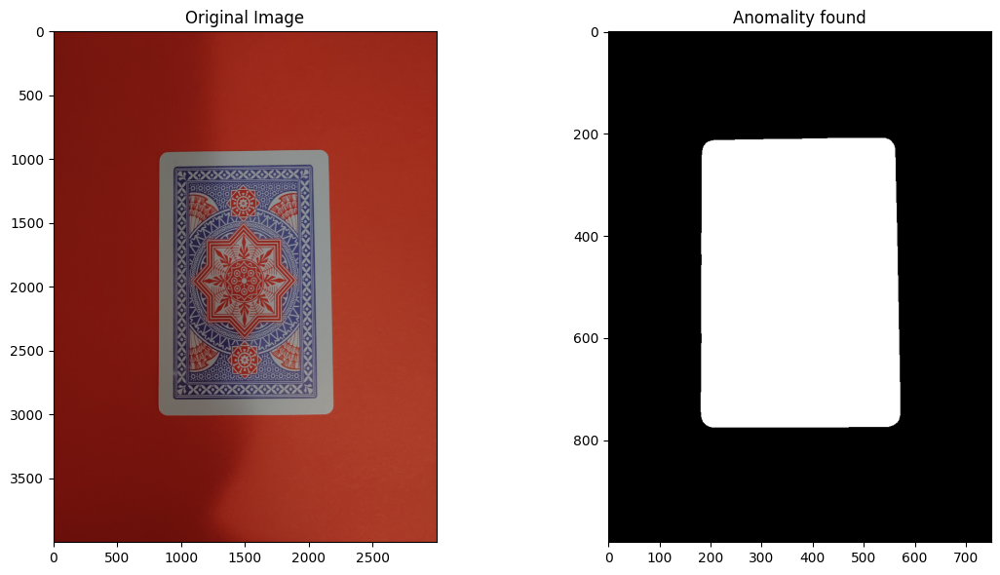

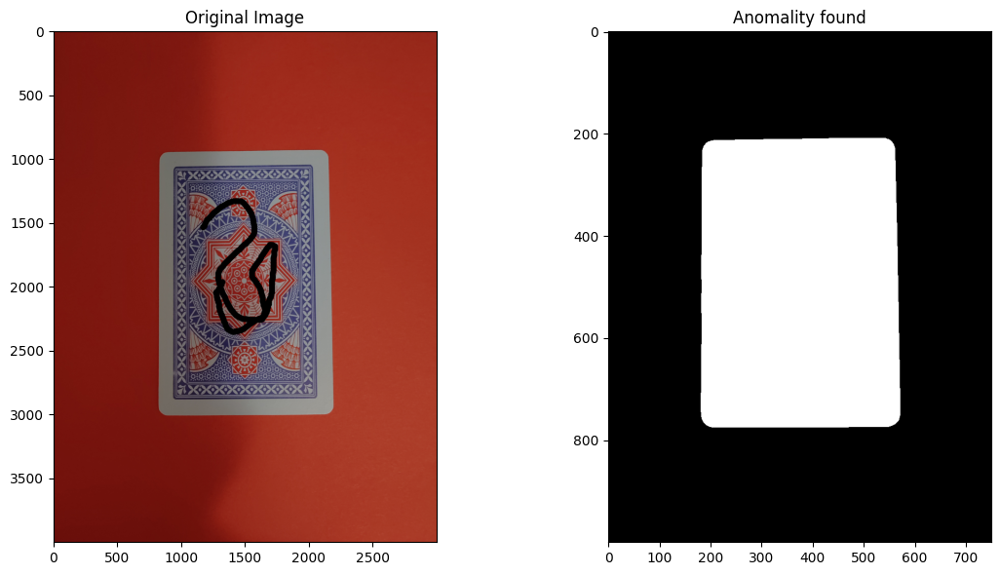

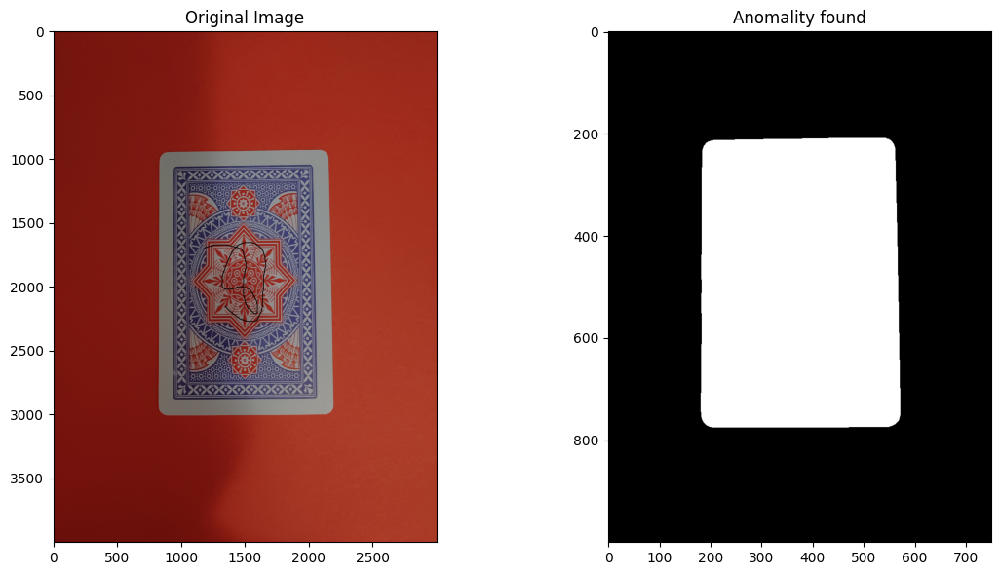

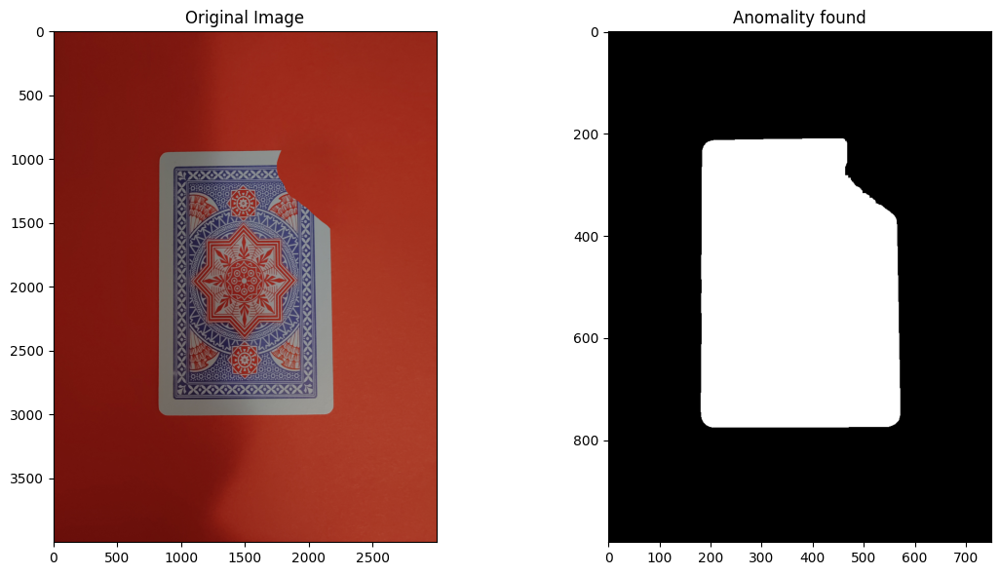

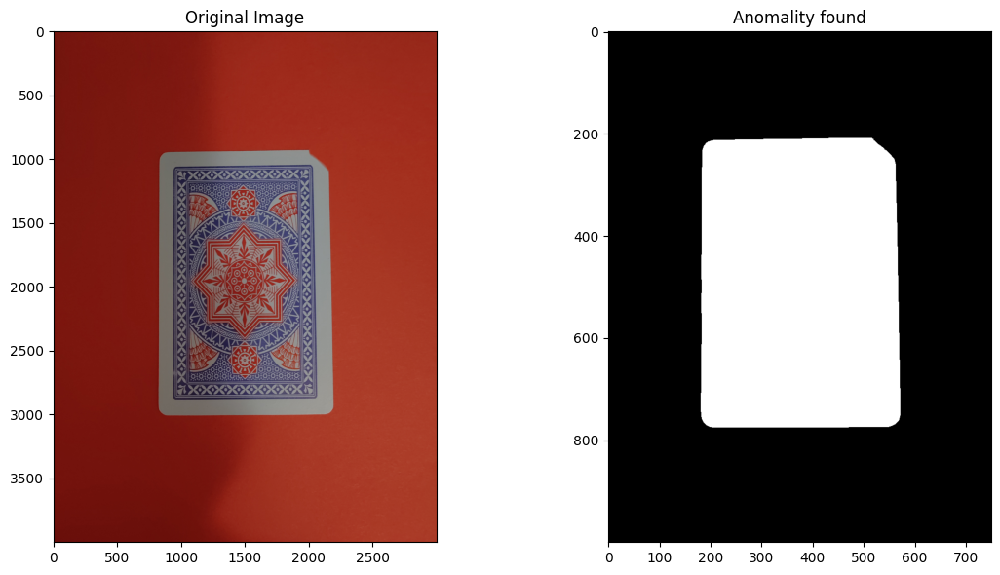

...

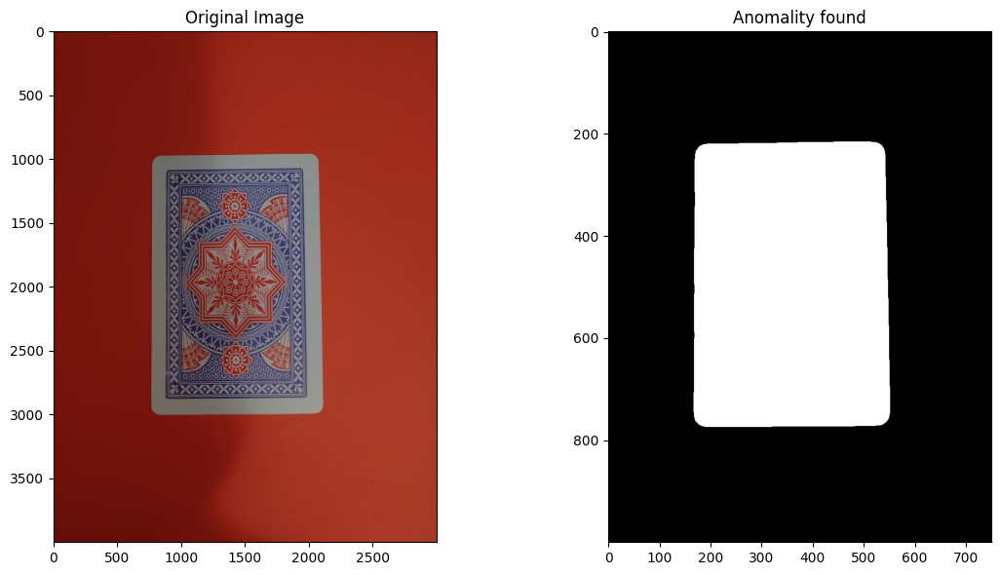

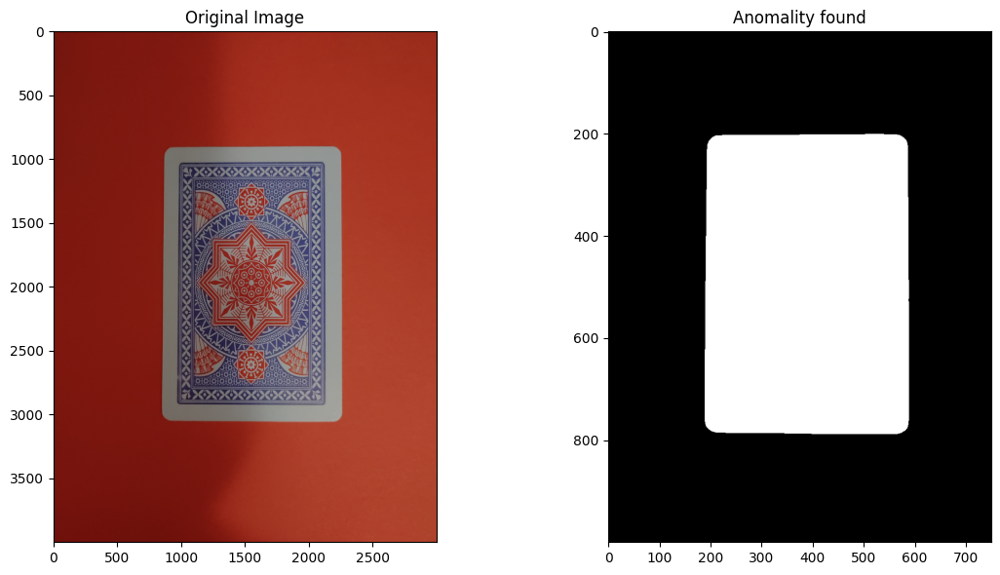

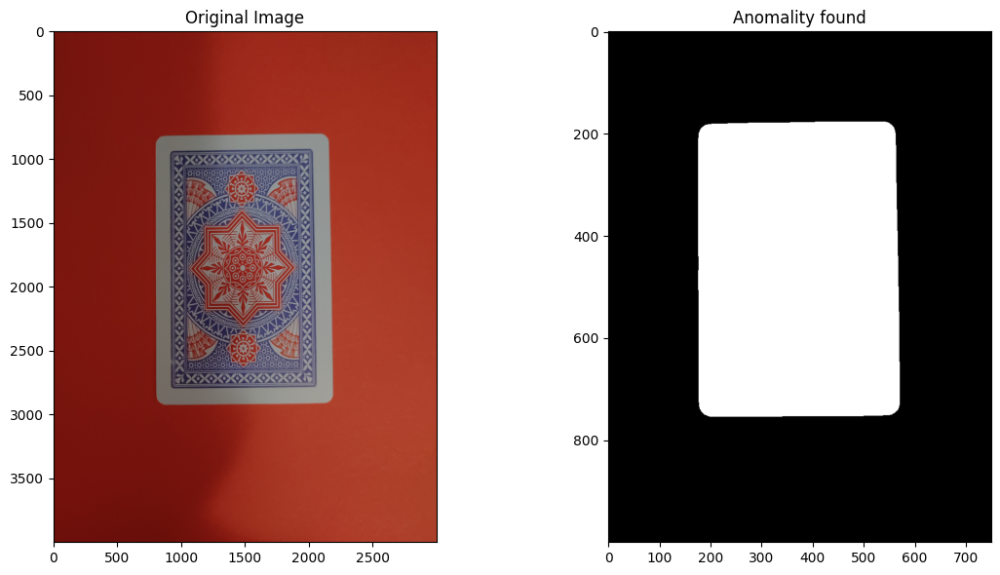

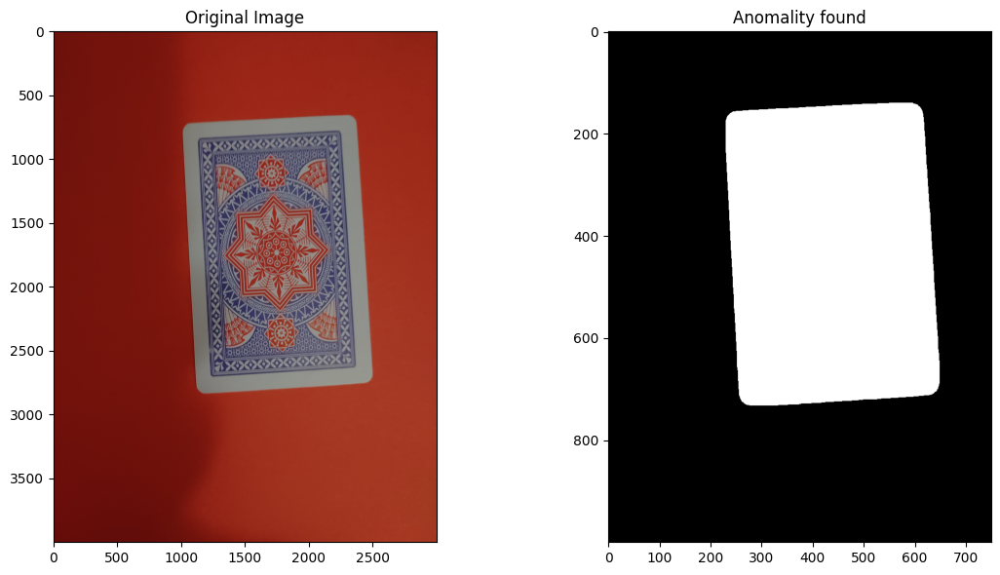

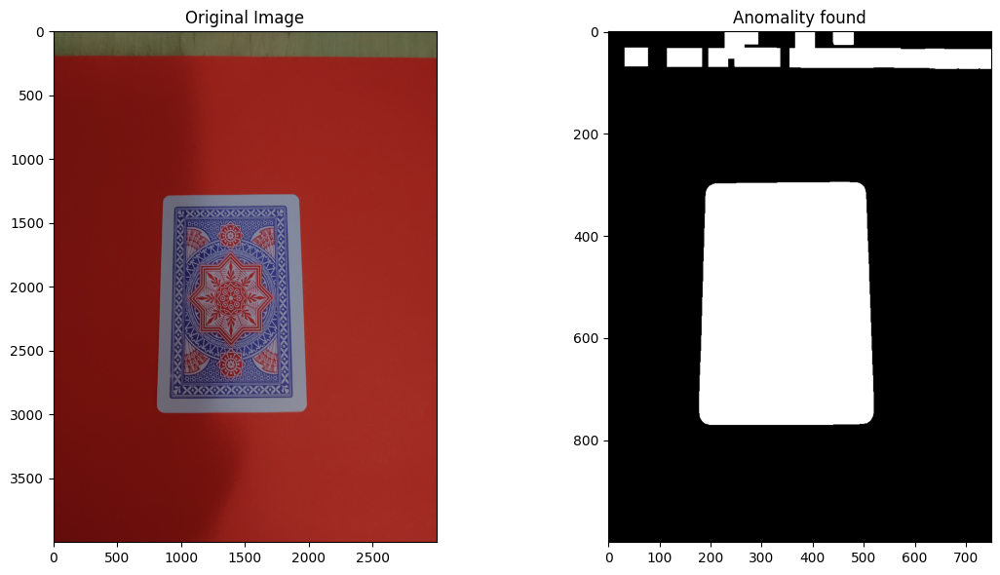

In [111]:
idx = 0
anomalities_in_imgs_v6 = []
for feature_diff in extract_feats:
    a5,anomaly_detected = detect_anomalies6(feature_diff, best_thresholds_v6)
    anomalities_in_imgs_v6.append(a5)
    img_ifAnomaly = load_and_preprocess_v3(img_listx[idx])
    imageAnomality(img_listx[idx],img_ifAnomaly,anomaly_detected)
    idx = idx +1    

Testing 2 variations of anomalitie detection, once with Hu Moments,HOG Features and LBP histogram and other time with statistic features.

In [122]:
threshold_ranges_v6_v1 = {
    'Hu Moments': [1.3e-8, 1e-7,5e-7, 1e-6, 5e-6, 1e-5,5e-5,1e-4],
    'HOG Features': [0.67, 0.7, 0.75,0.8,0.85,0.9 ,1.0, 1.1, 1.2],
    "LBP Histogram": [0.00000001,0.0000001,0.000001,0.00001, 0.0002, 0.0004,0.00045, 0.0005],
    
   
}
threshold_ranges_v6_v2 = {
    "Mean": [0.05,0.1, 0.5 , 0.7, 0.8, 0.9, 1.0, 1.2,6],
    "Standard Deviation": [0.001,0.002,0.005,0.01, 0.2, 0.4, 0.6, 0.8, 1.0,3],
    "Skewness": [0.0001,0.003,0.005,0.002, 0.005, 0.01, 0.02,0.03],
    "Kurtosis": [0.01,0.0025, 0.005, 0.01, 0.03, 0.05,0.7, 0.1, 0.2,0.3],
   
}

In [123]:
thresholds_dict_v6_v1 = thresholds_dicts(threshold_ranges_v6_v1)
thresholds_dict_v6_v2 = thresholds_dicts(threshold_ranges_v6_v2)

In [147]:
best_thresholds_v6_v1, best_acc_score_v6_v1 = optimize_thresholds_v3_v1(thresholds_dict_v6_v1, X_train_v6, y_train_v6)
print("Best Thresholds:", best_thresholds_v6_v1)
print("Best Accuracy Score:", best_acc_score_v6_v1)

Best Thresholds: {'Hu Moments': 1e-06, 'HOG Features': 1.2, 'LBP Histogram': 0.0004}
Best Accuracy Score: 0.6428571428571429


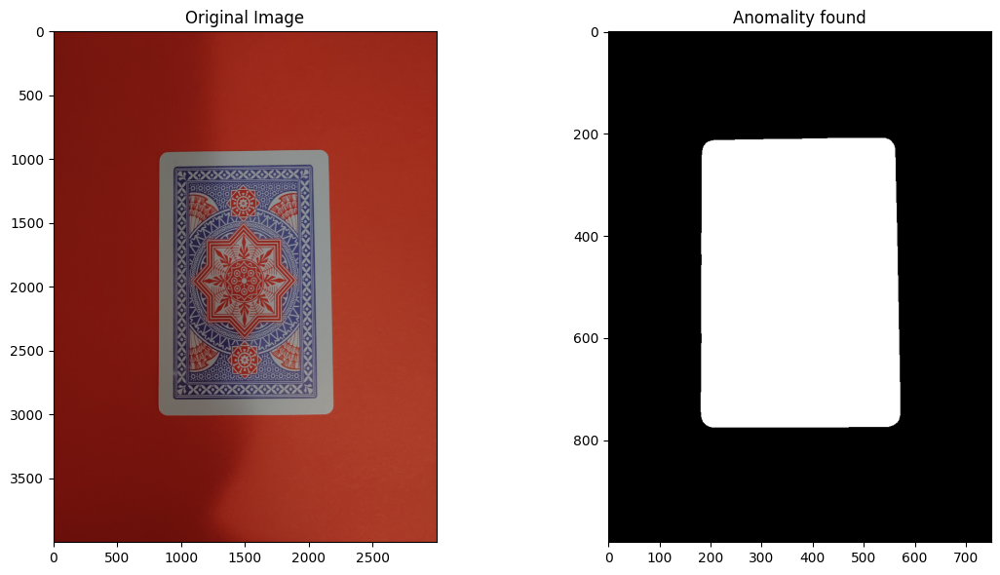

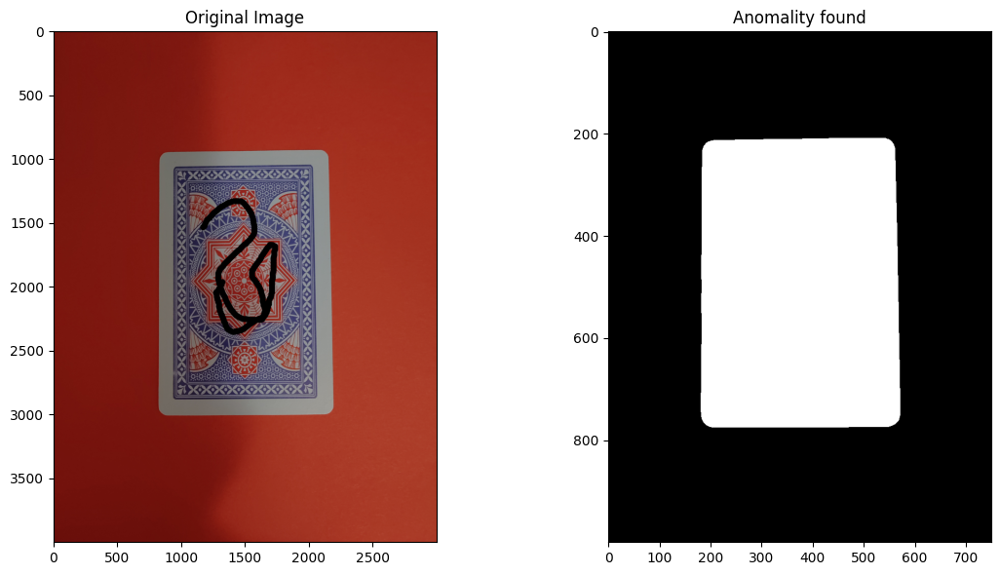

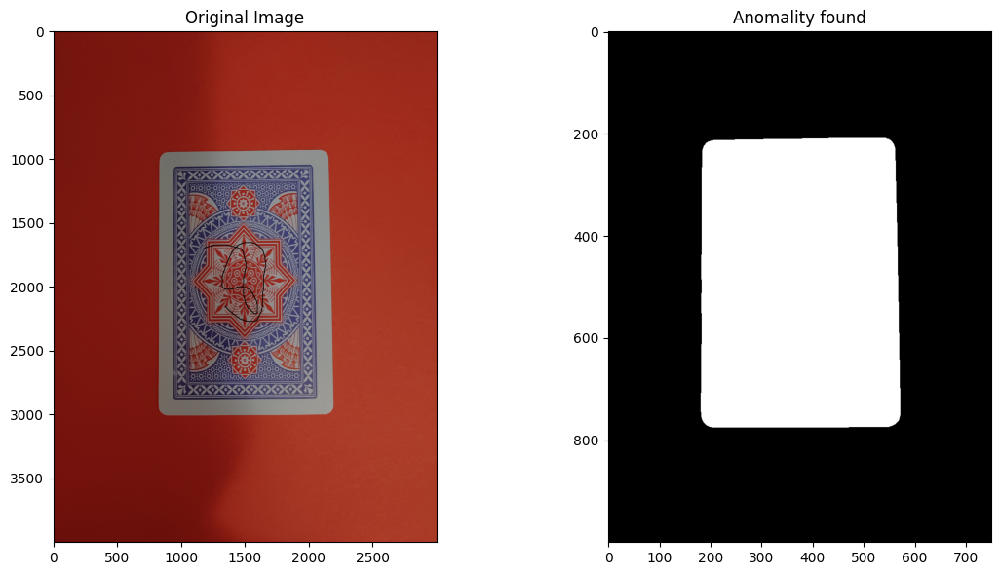

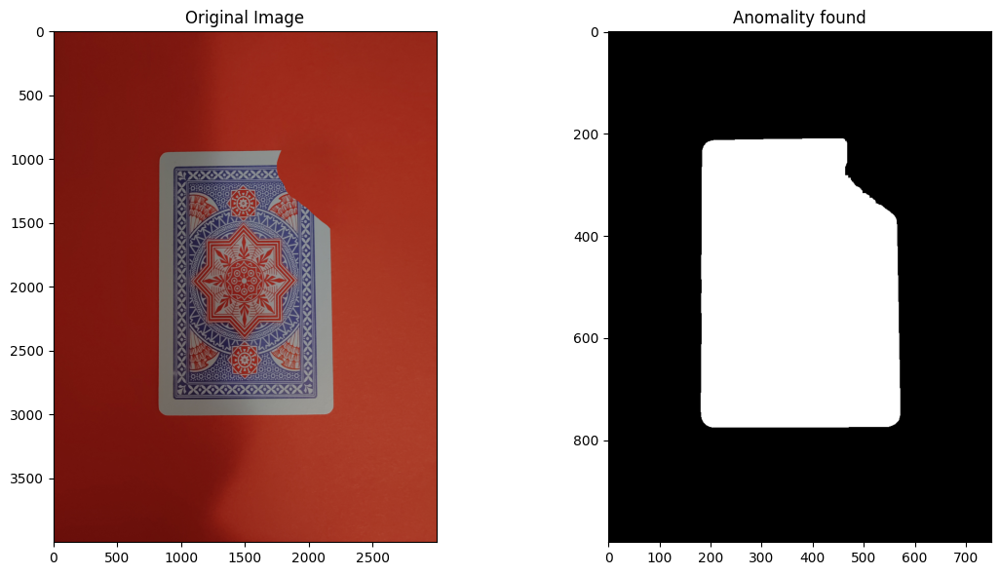

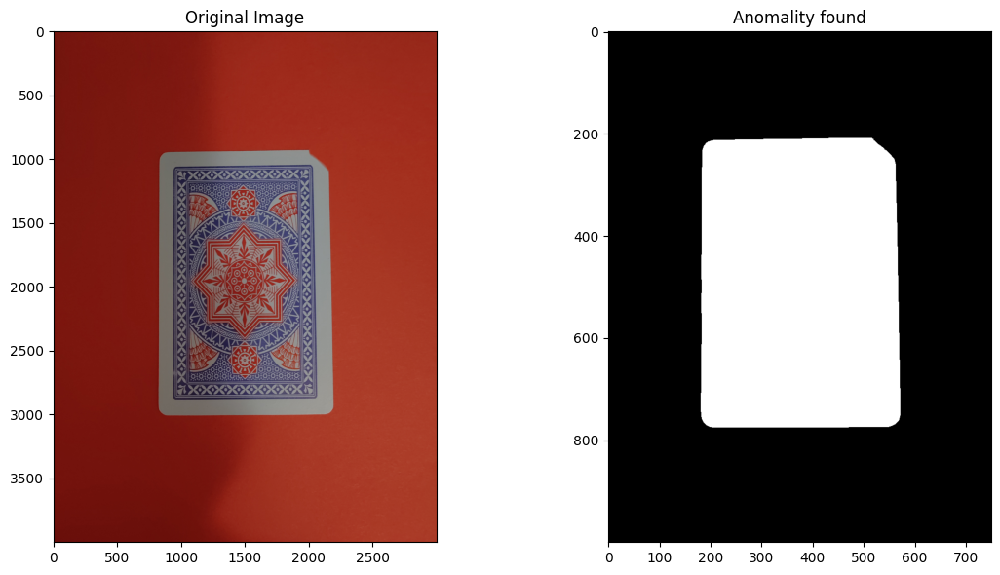

...

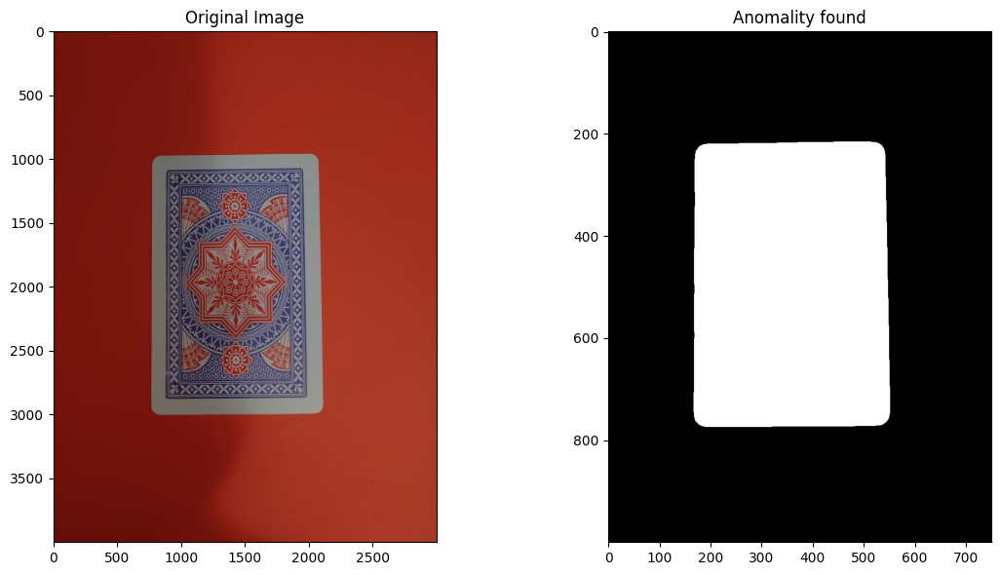

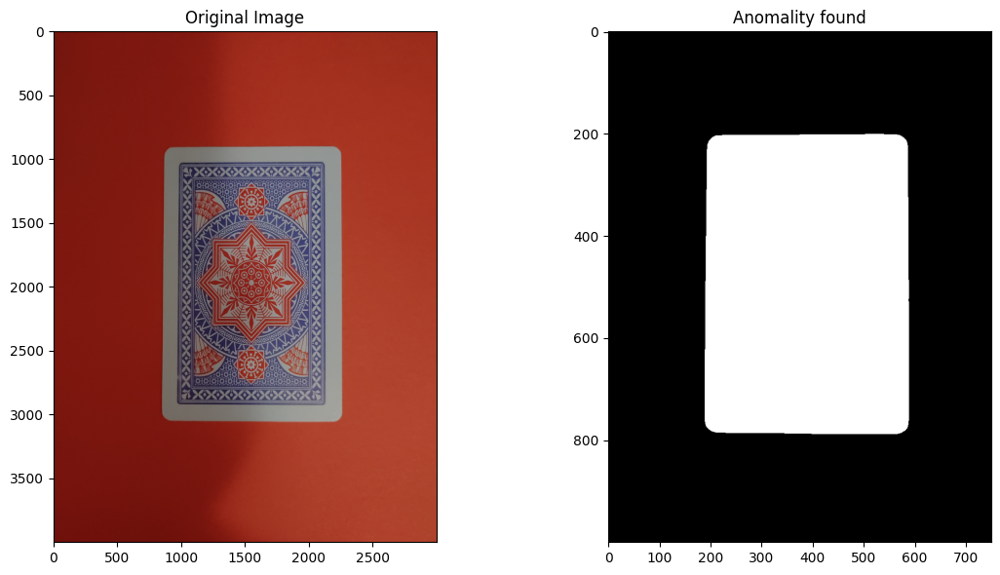

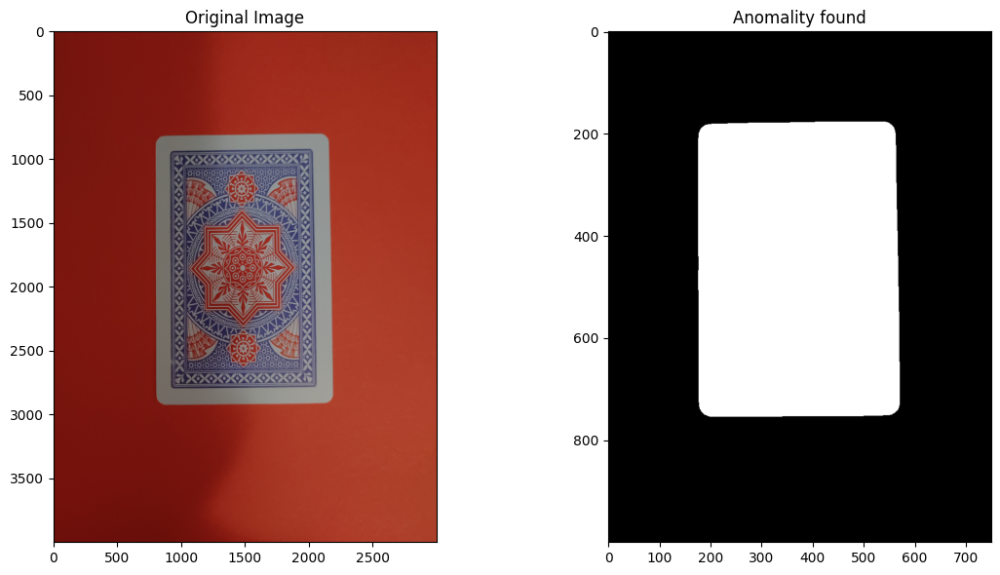

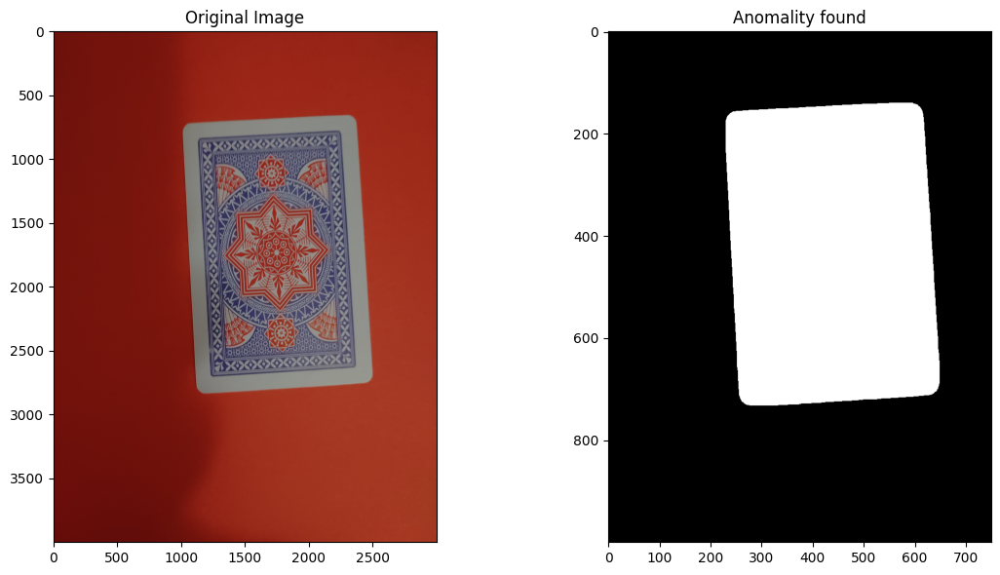

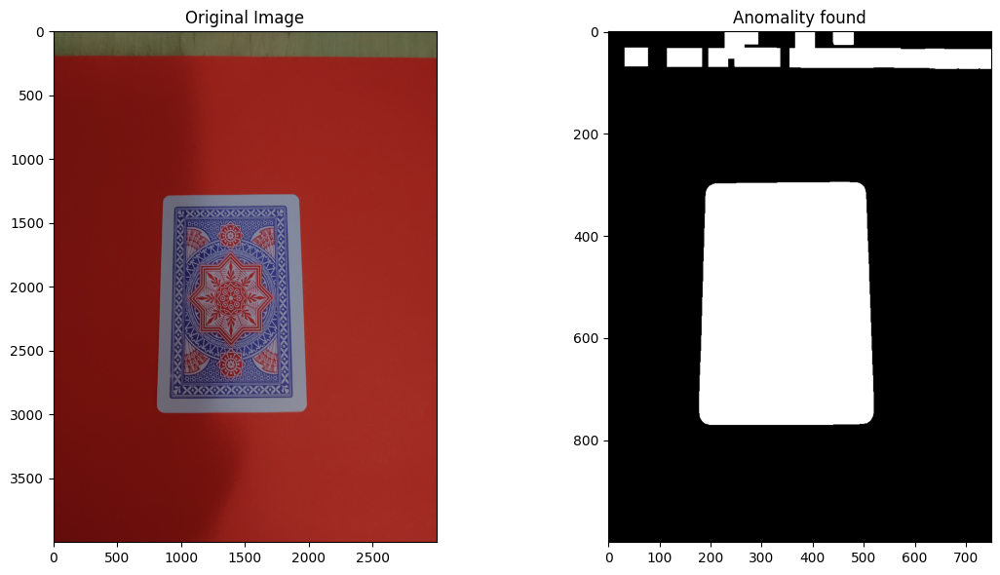

In [149]:
idx = 0
anomalities_in_imgs_v6_v1 = []
for feature_diff in extract_feats:
    a5,anomaly_detected = detect_anomalies6_v1(feature_diff, best_thresholds_v6_v1)
    anomalities_in_imgs_v6_v1.append(a5)
    img_ifAnomaly = load_and_preprocess_v3(img_listx[idx])
    imageAnomality(img_listx[idx],img_ifAnomaly,anomaly_detected)
    idx = idx +1    

In [148]:
best_thresholds_v6_v2, best_acc_score_v6_v2 = optimize_thresholds_v3_v2(thresholds_dict_v6_v2, X_train_v6, y_train_v6)
print("Best Thresholds:", best_thresholds_v6_v2)
print("Best Accuracy Score:", best_acc_score_v6_v2)

Best Thresholds: {'Mean': 6, 'Standard Deviation': 3, 'Skewness': 0.02, 'Kurtosis': 0.7}
Best Accuracy Score: 0.7142857142857143


# Results

At the end the following are the best parameters i have found for the anomalitie detection.

In [187]:
best_thresholds_found = {
     'Hu Moments': 1e-06,
     'HOG Features': 3,
     'LBP Histogram': 0.0005,
     'PCA Features': 4e-15
    }

In [190]:
features_diff_list

[{'Hu Moments': 0.0,
  'HOG Features': 0.0,
  'LBP Histogram': 0.0,
  'Mean': 0.0,
  'Standard Deviation': 0.0,
  'Skewness': 0.0,
  'Kurtosis': 0.0,
  'PCA Features': 0.0},
 {'Hu Moments': 2.42943749631519e-07,
  'HOG Features': 0.8840035248629476,
  'LBP Histogram': 9.276061363472365e-09,
  'Mean': 0.05303999999999576,
  'Standard Deviation': 0.024623868849332098,
  'Skewness': 0.0002694786851207276,
  'Kurtosis': 0.002070542162893485,
  'PCA Features': 3.1086244689504383e-15},
 {'Hu Moments': 2.42943749631519e-07,
  'HOG Features': 0.8840035248629476,
  'LBP Histogram': 9.276061363472365e-09,
  'Mean': 0.05303999999999576,
  'Standard Deviation': 0.024623868849332098,
  'Skewness': 0.0002694786851207276,
  'Kurtosis': 0.002070542162893485,
  'PCA Features': 3.1086244689504383e-15},
 {'Hu Moments': 1.4906488140655578e-06,
  'HOG Features': 1.9685662701787692,
  'LBP Histogram': 2.4935167160511362e-05,
  'Mean': 3.8474399999999918,
  'Standard Deviation': 1.8641219074058881,
  'Skewne

#### Testing the best thresholds on the data

In [196]:
old_labels = [0,1,1,1,1,1,0,1,1,1,1,1,0,0,0,0,0,0] # The normal labels, considering any change from the norm as defect
new_labels = [0,0,0,1,1,0,0,0,0,1,1,0,0,0,0,0,0,0] # Considering only defects to the shame of the card as anomalitie(cut/torn)

In [194]:
# Create an empty list to store anomaly detection results
anomalies_found = []

# Iterate over whole data and apply the anomaly detection function
for feature_diff in features_diff_list:  
    # Apply the best thresholds to detect anomalies
    a,anomaly_detected_test = detect_anomalies5(feature_diff, best_thresholds_found)
    
    # Append the result (True for anomaly, False for normal) to the results list
    anomalies_found.append(anomaly_detected_test)
    
f1_best_1 = f1_score(old_labels, anomalies_found)
print("F1-score:", f1_best_1)

F1-score: 0.5555555555555556


In [195]:
# Create an empty list to store anomaly detection results
anomalies_found = []

# Iterate over whole data and apply the anomaly detection function
for feature_diff in features_diff_list:  
    # Apply the best thresholds to detect anomalies
    a,anomaly_detected_test = detect_anomalies5(feature_diff, best_thresholds_found)
    
    # Append the result (True for anomaly, False for normal) to the results list
    anomalies_found.append(anomaly_detected_test)
    
f1_best_1 = f1_score(new_labels, anomalies_found)
print("F1-score:", f1_best_1)

F1-score: 0.6666666666666666


In [ ]:
# Printing the images with the result after the detection analysis
idx = 0
result_lables = []
anomalities_in_imgs_best = []
for feature_diff in features_diff_list:
    a5,anomaly_detected = detect_anomalies5(feature_diff, best_thresholds_found)
    result_lables.append(int(anomaly_detected))
    anomalities_in_imgs_best.append(a5)
    img_ifAnomaly = load_and_preprocess_v3(img_listx[idx])
    imageAnomality(img_listx[idx],img_ifAnomaly,anomaly_detected)
    idx = idx +1    

# Graphs and other visualizations

The following function perform sensitivity analysis on feature thresholds and generate data for visualization.


    Input:
        model: The anomaly detection model (takes thresholds and images features as input to calcualte labels).
        baseline_thresholds (dict): The baseline threshold configuration(the thresholds that gave the best results).
        feature_ranges (dict): Ranges of threshold values to explore for each feature.
        data (list): List of feature diffrences dictionaries for each data point.
        labels (list): List of labels for the images (0 for non-defective, 1 for defective).

    Returns:
        sensitivity_data (dict): A dictionary containing sensitivity analysis results.


In [297]:
# model = anomalitie_detection_model 
# baseline_thresholds = best_thresholds_found
feature_ranges = {
     'Hu Moments': [1e-07,5e-07,1.2e-06,5e-06,1e-05],
     'HOG Features': [0.6,0.8,1.1,1.5,2,4.2],
     'LBP Histogram': [1e-07,1e-06,1e-05,2.0e-04,3.0e-04,4.2e-04],
     'PCA Features': [1.8e-15,2e-15,3.25e-15,3.3e-15,3.9e-15,4.9e-15]
     }
data = features_diff_list
# lables = new_labels or old_labels

In [410]:
# With new_labels
sensitivity_data1 = sensitivity_analysis2(anomalitie_detection_model, best_thresholds_found, feature_ranges, data, new_labels)


In [411]:
# With old_labels
sensitivity_data2 = sensitivity_analysis2(anomalitie_detection_model, best_thresholds_found, feature_ranges, data, old_labels)


In [304]:
best_thresholds_found

{'Hu Moments': 1e-06,
 'HOG Features': 3,
 'LBP Histogram': 0.0005,
 'PCA Features': 4e-15}

### Seeing the diffrences of the lables in the sensitivity analysis

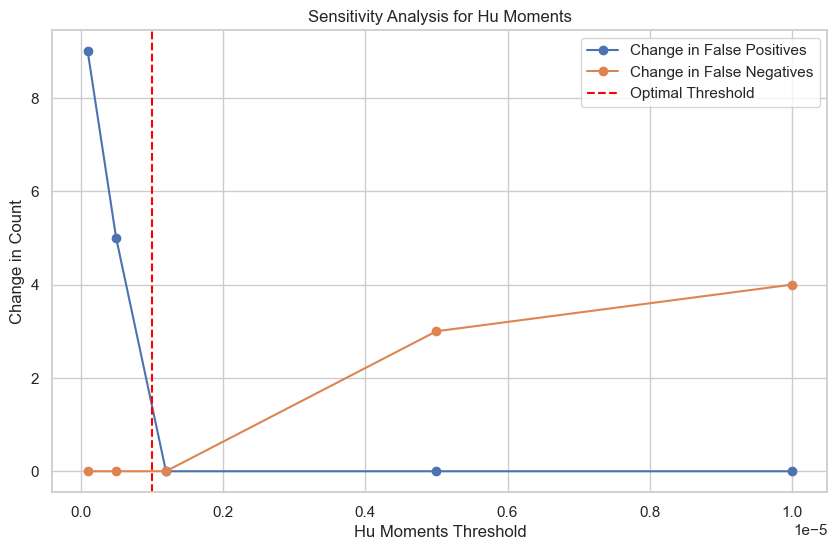

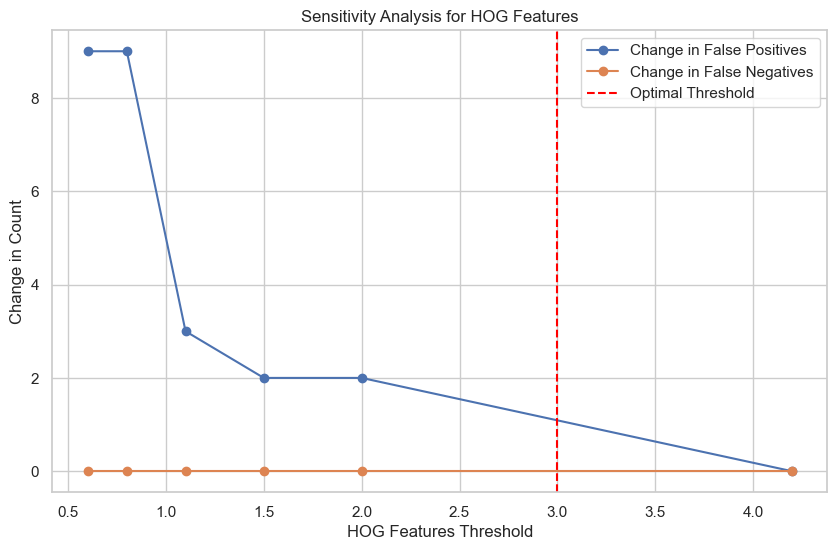

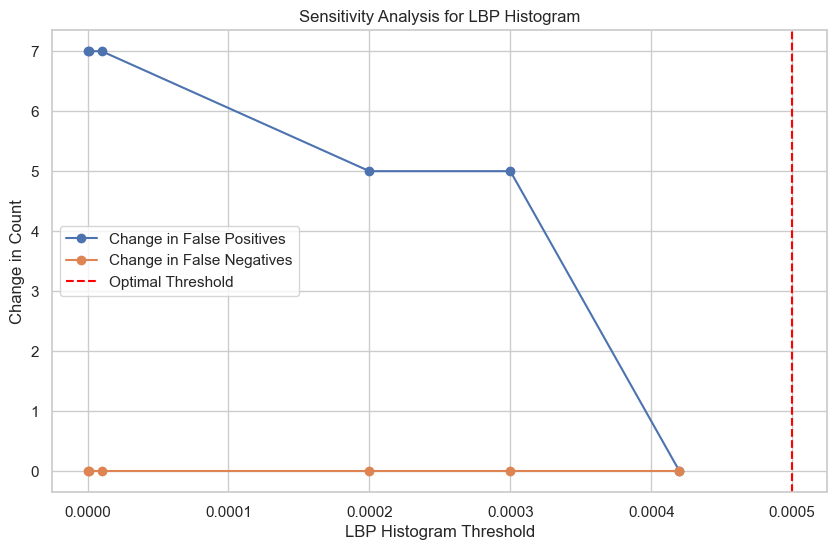

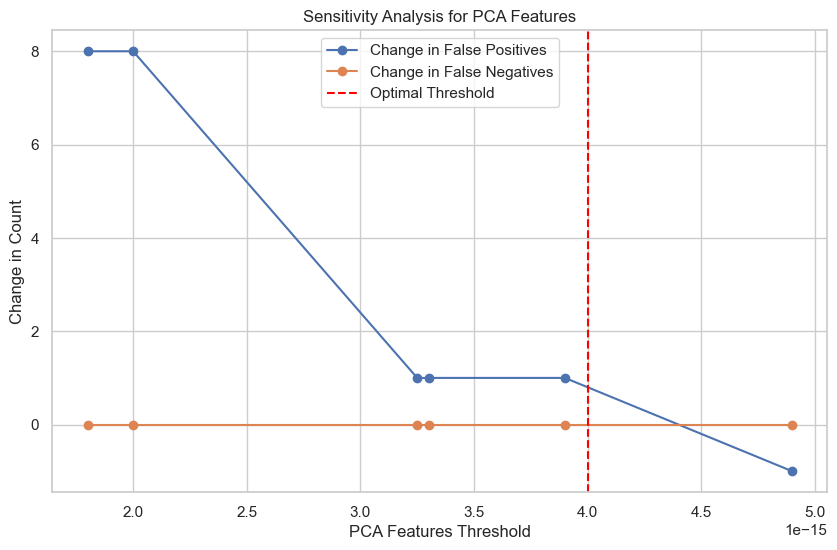

In [412]:
# With new labels
plot_sensitivity_analysis_v2(sensitivity_data1,best_thresholds_found)

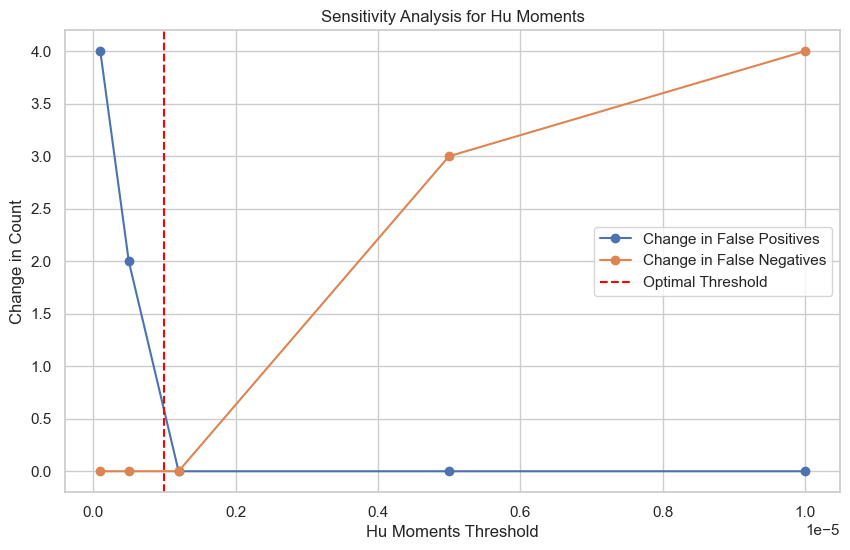

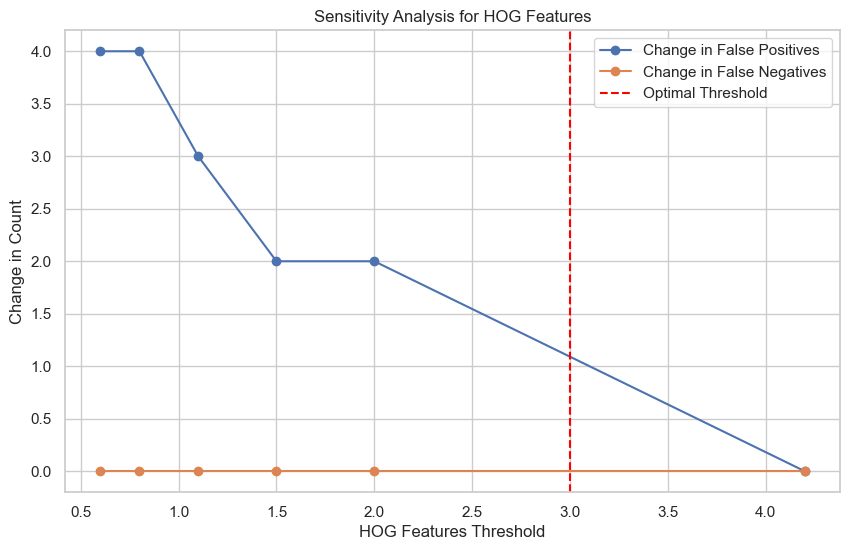

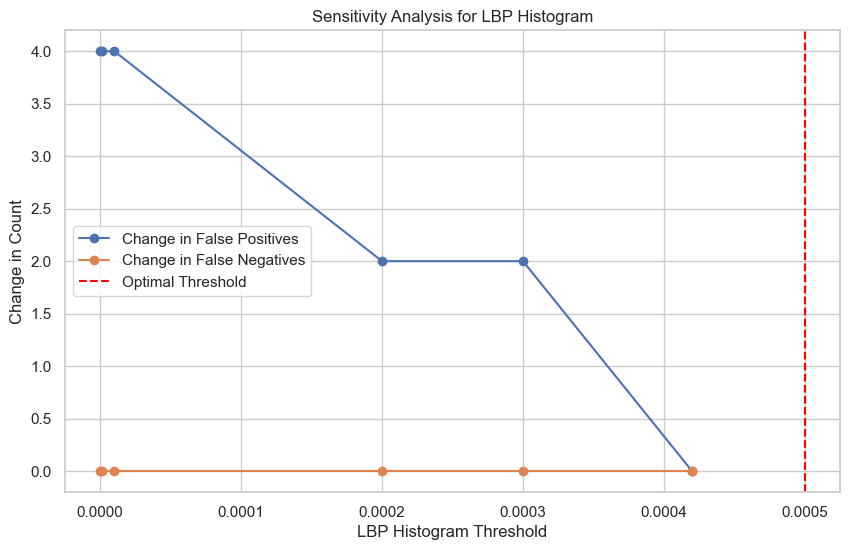

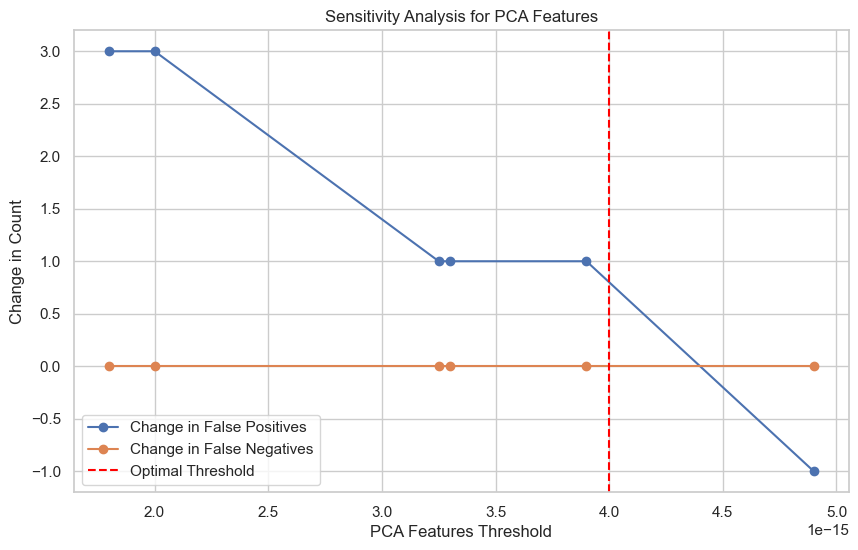

In [413]:
# With old labels
plot_sensitivity_analysis_v2(sensitivity_data2,best_thresholds_found)

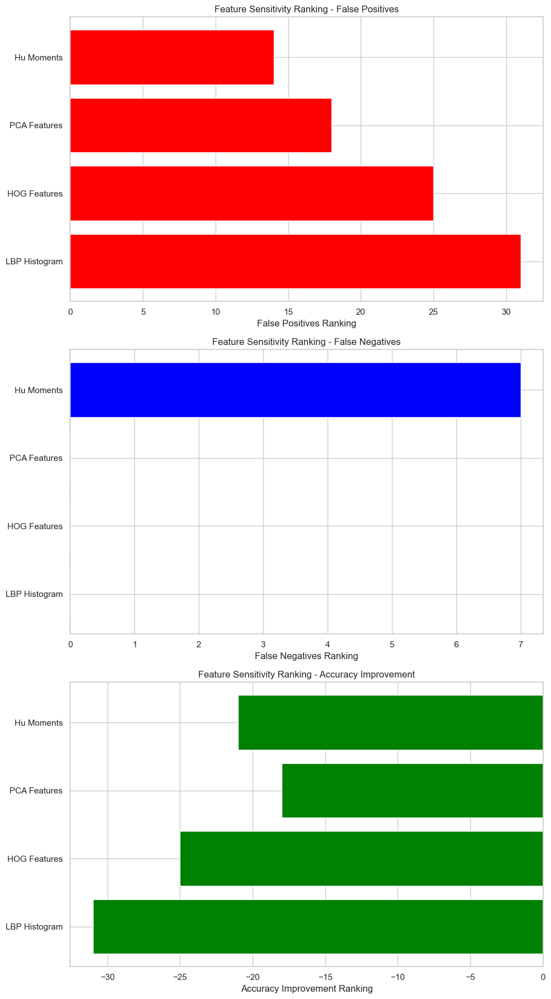

In [418]:
# New Lables
ranked_features1 = rank_feature_sensitivities(sensitivity_data1)
plot_feature_sensitivity_ranking(ranked_features1)

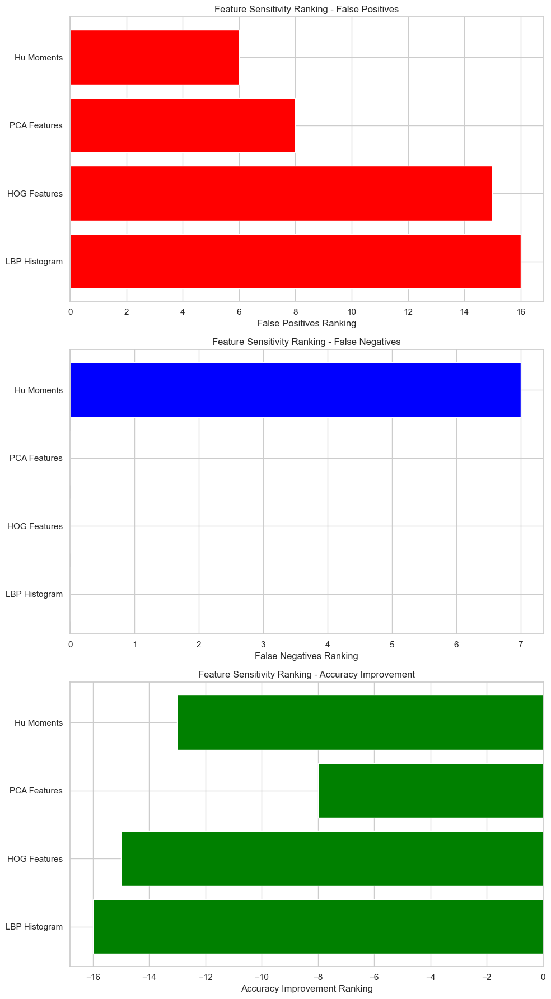

In [419]:
# Old lables
ranked_features2 = rank_feature_sensitivities(sensitivity_data2)
plot_feature_sensitivity_ranking(ranked_features2)

## Accuracy comperison between the 2 lables

As we can see, if focusing on 1 type of defects the accuracy is much higher

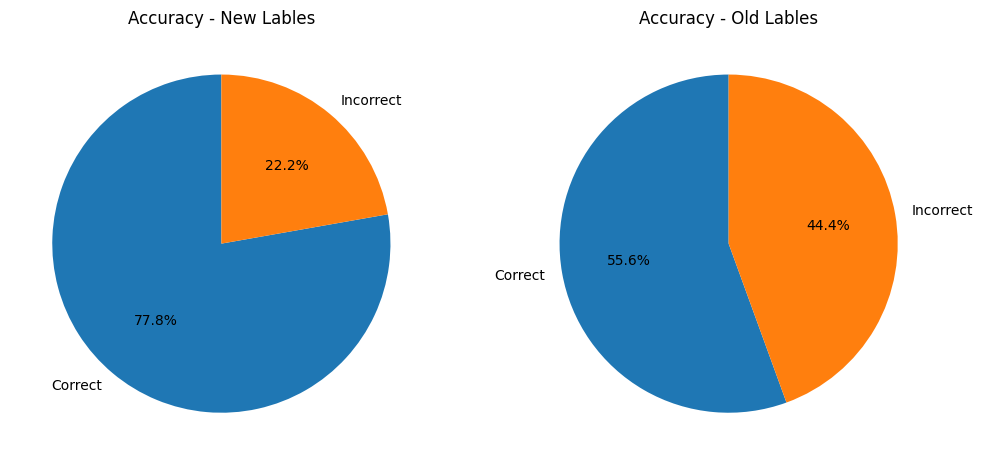

In [333]:
plot_accuracy_comparison(new_labels,"Accuracy - New Lables",old_labels,"Accuracy - Old Lables",result_lables)

## Comparing the results with each of the lables sets

#### New lables

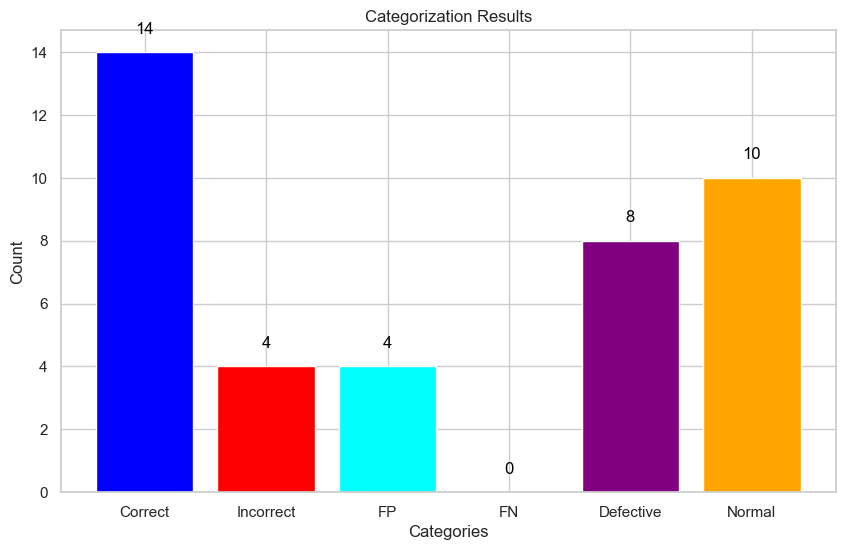

In [366]:
# Categories are: 
# 'Correct' = how many images the model identified correctly
# 'Incorrect' = how many images the model identified incorrectly
# 'FN' = False Positives, 'FN' = False Negatives, 'Defective' = Images found as having defects, 
# 'Normal' = Images found as not having defects

plot_categorization_results(new_labels,result_lables)

#### Old lables

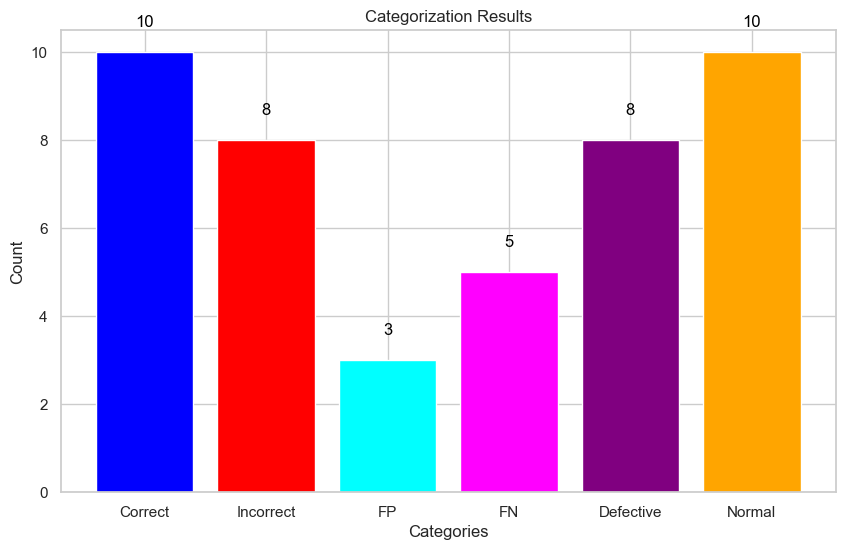

In [367]:
plot_categorization_results(old_labels,result_lables)

#### Comparison between both lables

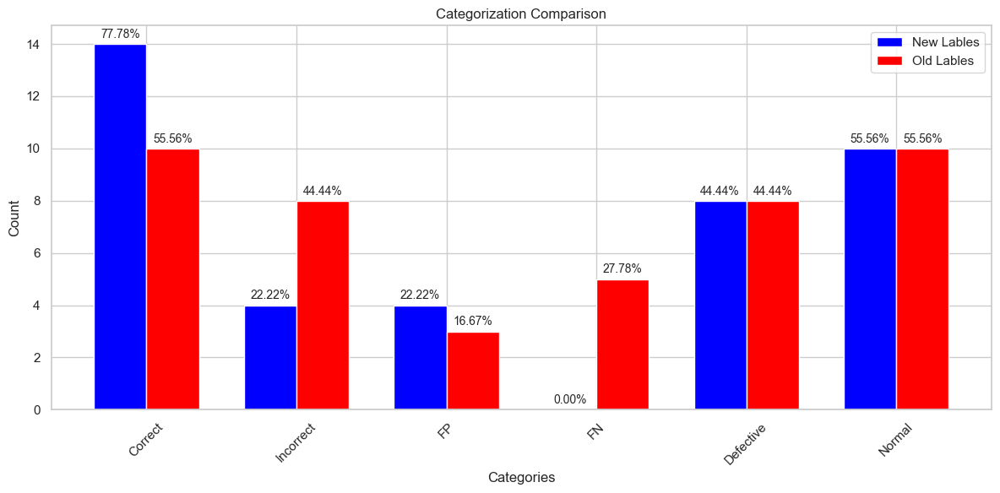

In [383]:
plot_categorization_comparison(new_labels,old_labels,result_lables,"New Lables","Old Lables")

# Conclusion

As we can see , there is much more to improve but atleast from the results there can be said that with the process of the preprocessing i have done i had much easier time extracting and using features for on type of defects than the others.

It was much easier to identifiy defects of the shape of the card, like the card bein torn or cut than to identifiy correctly images that had other types of defects such as drawings over them or stickers.

But withing those limitetions atleast this model can get satisfactionary results if i set the anomalies target as i described earlier and if i clean and preprocess the images in the same way.